# Programming Assignment 1 - Semantic Segmentation

**Professor:** Dário Oliveira  
**Monitor:** Lívia Meinhardt  
**Alunos:** Gustavo Bianchi, Guilherme Carvalho, Luiz Felipe

### Primeira parte: Definições de funções e Importação dos Dados

In [1]:
# =========================================================
#                       IMPORTS
# =========================================================

import os
import gc
import time
import math
import torch
import torchvision
import numpy as np
import pandas as pd
from PIL import Image
import torch.nn as nn
import albumentations as A
import torch.optim as optim
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch.utils.data import Dataset
from albumentations.pytorch import ToTensorV2
from torch.utils.data import DataLoader, random_split
from torchmetrics.classification import MulticlassJaccardIndex
from torchvision.models.segmentation import deeplabv3_resnet101, DeepLabV3_ResNet101_Weights

In [2]:
# =========================================================
#  DIMINUINDO O TAMANHO DAS IMAGENS PRA FACILITAR O TREINO
# =========================================================

# Dataset original
INPUT_TRAIN_IMAGES_DIR = "/kaggle/input/camvid/CamVid/train"
INPUT_TRAIN_MASKS_DIR = "/kaggle/input/camvid/CamVid/train_labels"
INPUT_VAL_IMAGES_DIR = "/kaggle/input/camvid/CamVid/val"       
INPUT_VAL_MASKS_DIR = "/kaggle/input/camvid/CamVid/val_labels"   

# Onde serão salvas as imagens redimencionadas
OUTPUT_TRAIN_IMAGES_DIR = "/kaggle/working/CamVid/train_256"
OUTPUT_TRAIN_MASKS_DIR = "/kaggle/working/CamVid/train_labels_256"
OUTPUT_VAL_IMAGES_DIR = "/kaggle/working/CamVid/val_256"         
OUTPUT_VAL_MASKS_DIR = "/kaggle/working/CamVid/val_labels_256"     

TARGET_SIZE = (256, 256) # (Largura, Altura)

# Função que redimensiona
def resize_images(input_dir, output_dir, size, is_mask=False):
    os.makedirs(output_dir, exist_ok=True)
    filenames = os.listdir(input_dir)
    for filename in tqdm(filenames, desc=f"Redimensionando {os.path.basename(input_dir)}"):
        input_path = os.path.join(input_dir, filename)
        output_path = os.path.join(output_dir, filename)
        with Image.open(input_path) as img:
            resample_method = Image.Resampling.NEAREST if is_mask else Image.Resampling.BICUBIC
            resized_img = img.resize(size, resample=resample_method)
            resized_img.save(output_path)

print("Redimensionando imagens de treino...")
resize_images(INPUT_TRAIN_IMAGES_DIR, OUTPUT_TRAIN_IMAGES_DIR, TARGET_SIZE, is_mask=False)
print("\nRedimensionando máscaras de treino...")
resize_images(INPUT_TRAIN_MASKS_DIR, OUTPUT_TRAIN_MASKS_DIR, TARGET_SIZE, is_mask=True)

print("\nRedimensionando imagens de validação...") 
resize_images(INPUT_VAL_IMAGES_DIR, OUTPUT_VAL_IMAGES_DIR, TARGET_SIZE, is_mask=False)
print("\nRedimensionando máscaras de validação...")
resize_images(INPUT_VAL_MASKS_DIR, OUTPUT_VAL_MASKS_DIR, TARGET_SIZE, is_mask=True)

print("\nPré-processamento concluído para treino e validação!")

Redimensionando imagens de treino...


Redimensionando train:   0%|          | 0/369 [00:00<?, ?it/s]


Redimensionando máscaras de treino...


Redimensionando train_labels:   0%|          | 0/369 [00:00<?, ?it/s]


Redimensionando imagens de validação...


Redimensionando val:   0%|          | 0/100 [00:00<?, ?it/s]


Redimensionando máscaras de validação...


Redimensionando val_labels:   0%|          | 0/100 [00:00<?, ?it/s]


Pré-processamento concluído para treino e validação!


In [3]:
# =========================================================
#             DEFININDO FUNÇÕES AUXILIARES
# =========================================================

# Função que converte máscara RGB para classes
def rgb_to_mask(rgb_mask_np, color_map):
    mask = np.zeros((rgb_mask_np.shape[0], rgb_mask_np.shape[1]), dtype=np.int64)
    
    for class_id, color in color_map.items():
        # Encontra todos os pixels que correspondem à cor atual
        mask[np.all(rgb_mask_np == color, axis=-1)] = class_id
        
    return mask

# Converte a máscara de IDs de classe de volta para uma imagem RGB
def mask_to_rgb(mask, color_map):
    rgb_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)
    for class_id, color in color_map.items():
        rgb_mask[mask == class_id] = color
    return rgb_mask

# Função que lê o CSV das classes e transforma em um dicionário
def create_color_map_from_csv(csv_path):
    df = pd.read_csv(csv_path)
    df = df.rename(columns = lambda x: x.strip()) # Tirando possíveis espaços nos nomes
    color_map = {}
    
    for index, row in df.iterrows():
        class_id = index
        color = (row['r'], row['g'], row['b'])
        color_map[class_id] = color
        
    return color_map

# Função pra exibir a situação do treinamento
def check_predictions(loader, model, color_map, device="cpu"):
    model.eval()
    image_tensor, mask_tensor = next(iter(loader))
    image_tensor = image_tensor.to(device, dtype=torch.float32)
    mask_tensor = mask_tensor.to(device)

    with torch.no_grad():
        preds_tensor = model(image_tensor)
        final_preds = torch.argmax(preds_tensor, dim=1)
        
    image_np = denormalize_img(image_tensor[0]).permute(1, 2, 0).cpu().numpy()
    image_np = image_np
    image_np = np.clip(image_np, 0, 1) 

    true_mask_np = mask_tensor[0].cpu().numpy()
    pred_mask_np = final_preds[0].cpu().numpy()
    true_mask_rgb = mask_to_rgb(true_mask_np, color_map)
    pred_mask_rgb = mask_to_rgb(pred_mask_np, color_map)
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 7))
    ax1.imshow(image_np); ax1.set_title("Imagem Original"); ax1.axis('off')
    ax2.imshow(true_mask_rgb); ax2.set_title("Máscara Verdadeira"); ax2.axis('off')
    ax3.imshow(pred_mask_rgb); ax3.set_title("Máscara Predita"); ax3.axis('off')
    plt.show()

# Função pra plotar os gráficos de loss
def plot_all_results(results_dict):
    plt.figure(figsize=(18, 8))
    plt.subplot(1, 2, 1)
    
    for test_name, history in results_dict.items():
        plt.plot(history['val_loss'], label=test_name, marker='o', linestyle='--')
    plt.title('Comparação da Perda de Validação (Validation Loss)')
    plt.xlabel('Épocas')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
   
    plt.subplot(1, 2, 2)
    for test_name, history in results_dict.items():
        plt.plot(history['val_iou'], label=test_name, marker='o', linestyle='--')
    plt.title('Comparação do IoU de Validação')
    plt.xlabel('Épocas')
    plt.ylabel('IoU')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)

    plt.suptitle('Comparativo de Desempenho dos Modelos', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Pra visualizar as imagens
def denormalize_img(t_img):
    t = t_img.detach().clone()
    MEAN = np.array([0.485, 0.456, 0.406], dtype=np.float32)
    STD  = np.array([0.229, 0.224, 0.225], dtype=np.float32)
    for c in range(3):
        t[c] = t[c] * STD[c] + MEAN[c]  
    t = t.clamp(0, 1)                 
    return t

# Função pra avaliar o IoU por classe dos modelos já treinados
def evaluate_per_class(model, loader, device, class_names):
    iou_metric = MulticlassJaccardIndex(
        num_classes=len(class_names), average='none'
    ).to(device)
    
    model.eval()
    with torch.no_grad():
        for images, masks in tqdm(loader, desc="Avaliando por classe"):
            images = images.to(device, dtype=torch.float32)
            masks  = masks.to(device, dtype=torch.long)
            preds  = model(images)
            iou_metric.update(preds, masks)
            
    per_class_iou = iou_metric.compute().detach().cpu().numpy()
    
    results_df = pd.DataFrame({
        'class_name': class_names,
        'iou': per_class_iou
    })
    return results_df

In [4]:
# =========================================================
#             DEFININDO CLASSE DO DATASET
# =========================================================

# Classe do Dataset 
class CamVidDataset(Dataset):
    def __init__(self, images_dir, masks_dir, color_map, data_augmentation=False):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.color_map = color_map
 
        transforms_list = [
            # Facilita o treinamento
            A.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225), max_pixel_value=255.0),
        ]

        # Como as imagens são sempre de carros, pedestres, não faz sentido treinar em imagens
        # rotacionadas de qualquer ângulo, então estou rotacionando com um limite de 15°
        
        # Para que o data_augmentation seja um parâmetro
        if data_augmentation:
            transforms_list.insert(1, A.Rotate(limit=10, p=0.3))
            transforms_list.insert(1, A.HorizontalFlip(p=0.5))

        transforms_list.append(ToTensorV2())
        
        self.transforms = A.Compose(transforms_list)

        self.image_filenames = sorted(os.listdir(images_dir))
        self.mask_filenames = sorted(os.listdir(masks_dir))

        assert len(self.image_filenames) == len(self.mask_filenames), \
            "O número de imagens e máscaras não é o mesmo."

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        image_path = os.path.join(self.images_dir, self.image_filenames[idx])
        mask_path = os.path.join(self.masks_dir, self.mask_filenames[idx])

        # Carrega a imagem e a máscara RGB
        image = Image.open(image_path).convert("RGB")
        rgb_mask = Image.open(mask_path).convert("RGB")
        
        # Converte a máscara para NumPy para processamento
        rgb_mask_np = np.array(rgb_mask)
        
        # Converte a máscara RGB para uma máscara de classes (formato NumPy)
        # Esta é a etapa mais importante para o ground truth
        mask = rgb_to_mask(rgb_mask_np, self.color_map)

        # Aplica transformações usando Albumentations
        if self.transforms:
            augmented = self.transforms(image=np.array(image), mask=mask)
            image = augmented['image']
            mask = augmented['mask']

        return image, mask


Dataset carregado com sucesso! Contém 369 amostras.
Shape do tensor da imagem: torch.Size([3, 256, 256])
Shape do tensor da máscara: torch.Size([256, 256])


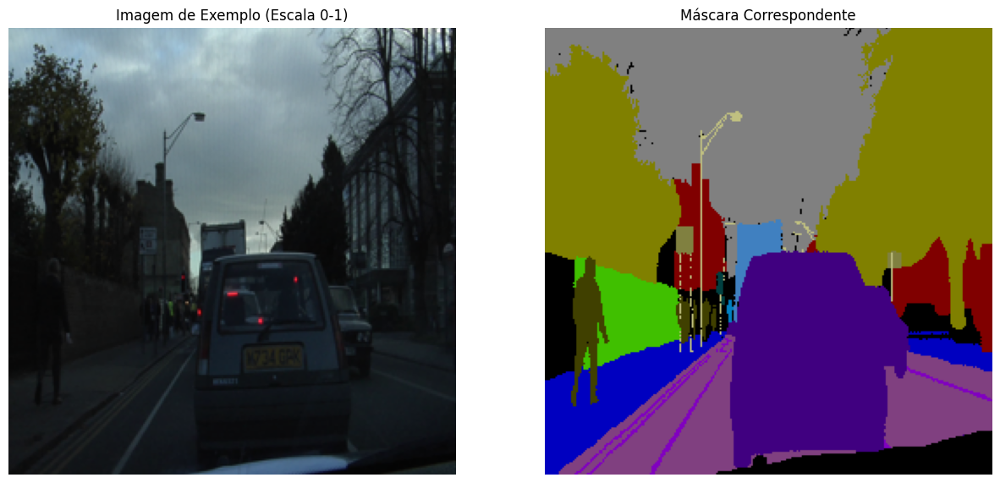

In [5]:
# =========================================================
#                   IMPORTANDO OS DADOS
# =========================================================

# Criando color_map a partir do csv
color_map = create_color_map_from_csv("/kaggle/input/camvid/CamVid/class_dict.csv")
class_names_df = pd.read_csv("/kaggle/input/camvid/CamVid/class_dict.csv")
num_classes = len(color_map)
class_names = class_names_df['name'].str.strip().tolist()

# Transformações são aplicadas nas imagens durante o treinamento pro modelo receber 
# imagens um pouco diferentes todas as vezes pra auxiliar na generalização

# Cria o DataSet de treino
train_dataset = CamVidDataset(
    images_dir="/kaggle/working/CamVid/train_256",
    masks_dir="/kaggle/working/CamVid/train_labels_256",
    color_map=color_map,
    data_augmentation=False
)

# Cria o DataSet de validação
val_dataset = CamVidDataset(
    images_dir="/kaggle/working/CamVid/val_256",
    masks_dir="/kaggle/working/CamVid/val_labels_256",
    color_map=color_map,
    data_augmentation=False # NUNCA ativamos augmentation para validação
)


if len(train_dataset) > 0:
    print(f"\nDataset carregado com sucesso! Contém {len(train_dataset)} amostras.")
    
    image_tensor, mask_tensor = train_dataset[0]
    
    print(f"Shape do tensor da imagem: {image_tensor.shape}")
    print(f"Shape do tensor da máscara: {mask_tensor.shape}")

    image_np = denormalize_img(image_tensor).permute(1, 2, 0).numpy()
    mask_np = mask_tensor.numpy()
    rgb_mask_np = mask_to_rgb(mask_np, color_map)

    # Mostrando a imagem de exemplo
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))
    ax1.imshow(image_np)
    ax1.set_title("Imagem de Exemplo (Escala 0-1)")
    ax1.axis('off')
    ax2.imshow(rgb_mask_np)
    ax2.set_title("Máscara Correspondente")
    ax2.axis('off')
    
    plt.show()

else:
    print("Dataset foi instanciado, mas está vazio.")

In [6]:
# =========================================================
#                    DEFININDO A UNET
# =========================================================

# Passo importante da UNet
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels), # Estabiliza o treinamento 
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels), # Estabiliza o treinamento
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        return self.conv(x)

# Classe da UNet com arquitetura variável dependendo dos parâmetros
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, depth=4, features=64):
        super().__init__()
        
        self.depth = depth 
        
        # Listas de enconders
        self.encoders = nn.ModuleList()
        self.upconvs = nn.ModuleList()
        self.decoders = nn.ModuleList()
        
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # Enconder
        for i in range(self.depth): 
            in_c = in_channels if i == 0 else features * (2**(i-1))
            out_c = features * (2**i)
            self.encoders.append(DoubleConv(in_c, out_c))
            
        self.bottleneck = DoubleConv(features * (2**(self.depth-1)), features * (2**self.depth))

        # Decoder
        for i in reversed(range(self.depth)):
            self.upconvs.append(
                nn.ConvTranspose2d(
                    features * (2**(i+1)), features * (2**i), kernel_size=2, stride=2
                )
            )
            self.decoders.append(
                DoubleConv(features * (2**(i+1)), features * (2**i))
            )
            
        self.final_conv = nn.Conv2d(features, out_channels, kernel_size=1)

    def forward(self, x):
        skip_connections = []

        # Encoder
        for encoder in self.encoders:
            x = encoder(x)
            skip_connections.append(x)
            x = self.pool(x)
        
        x = self.bottleneck(x)
        skip_connections = skip_connections[::-1]

        # Decoder
        for i in range(self.depth):
            x = self.upconvs[i](x)
            skip_connection = skip_connections[i]
            
            if x.shape != skip_connection.shape:
                x = F.interpolate(x, size=skip_connection.shape[2:])
            
            concat_skip = torch.cat((skip_connection, x), dim=1)
            x = self.decoders[i](concat_skip)

        return self.final_conv(x)

In [7]:
# =========================================================
#         CLASSES QUE GERENCIAM O TREINAMENTO
# =========================================================

class Trainer:
    def __init__(self, model, train_loader, val_loader, optimizer, loss_fn, device, num_classes):
        self.model = model
        self.train_loader = train_loader
        self.val_loader = val_loader
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.device = device
        self.iou_metric = MulticlassJaccardIndex(num_classes=num_classes).to(device) # Calcua o IoU de forma automática
        # Como não interfere no treino, vamos utilizar essa forma de calcular o IoU por ser comum. 
        # Ela atribui valores bem baixos no nosso caso

    def train_one_epoch(self):
        self.model.train()
        total_loss = 0
        loop = tqdm(self.train_loader, leave=False, desc="Training")
        for images, masks in loop:
            images = images.to(self.device, dtype=torch.float32)
            masks = masks.to(self.device, dtype=torch.long)
            predictions = self.model(images)
            loss = self.loss_fn(predictions, masks)
            total_loss += loss.item()
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
            loop.set_postfix(loss=loss.item())
        return total_loss / len(self.train_loader)

    def validate_one_epoch(self):
        self.model.eval()
        total_loss = 0
        self.iou_metric.reset()
        loop = tqdm(self.val_loader, leave=False, desc="Validation")
        with torch.no_grad():
            for images, masks in loop:
                images = images.to(self.device, dtype=torch.float32)
                masks = masks.to(self.device, dtype=torch.long)
                predictions = self.model(images)
    
                if isinstance(predictions, dict): # Pro caso do DeepLab
                    predictions = predictions['out']
                    
                loss = self.loss_fn(predictions, masks)
                total_loss += loss.item()
                self.iou_metric.update(predictions, masks)
                loop.set_postfix(loss=loss.item())
        iou = self.iou_metric.compute()
        return total_loss / len(self.val_loader), iou.item()
    
    def fit(self, epochs, patience, color_map):
        history = {'train_loss': [], 'val_loss': [], 'val_iou': []}
        best_val_loss = float('inf')
        patience_counter = 0
        
        for epoch in range(epochs):
            start_time = time.time()
            avg_train_loss = self.train_one_epoch()
            avg_val_loss, avg_iou = self.validate_one_epoch()
            end_time = time.time()
            epoch_duration = end_time - start_time

            print(f"Epoch [{epoch+1}/{epochs}] - Tempo: {epoch_duration:.2f}s - Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f} | Val IoU: {avg_iou:.4f}")

            history['train_loss'].append(avg_train_loss)
            history['val_loss'].append(avg_val_loss)
            history['val_iou'].append(avg_iou)

            if avg_val_loss < best_val_loss:
                best_val_loss = avg_val_loss
                patience_counter = 0
                torch.save(self.model.state_dict(), 'best_model.pth')
            else:
                patience_counter += 1

            if patience_counter >= patience:
                print(f"--- PARADA ANTECIPADA NA EPOCH {epoch+1} ---")
                break
            
            if (epoch + 1) % 10 == 0:
                check_predictions(self.val_loader, self.model, color_map, device=self.device)

        print("Treinamento finalizado. Carregando o melhor modelo encontrado...")
        self.model.load_state_dict(torch.load('best_model.pth'))
        return history

# Função de Perda Customizada 
class DiceLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = F.softmax(inputs, dim=1)
        targets = F.one_hot(targets, num_classes=inputs.shape[1]).permute(0, 3, 1, 2).float()
        inputs = inputs.reshape(-1)
        targets = targets.reshape(-1)
        intersection = (inputs * targets).sum()
        dice = (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)
        return 1 - dice


### Segunda Parte: Treino e Análise

#### Escolha de parâmetros

**Tamanho do Lote (Batch Size):**
O `batch_size` foi definido buscando maximizar a utilização da memória da GPU disponível. Lotes maiores permitem um processamento mais paralelo, o que acelera o tempo de treinamento por época e fornece uma estimativa de gradiente mais estável. Foram testados valores como 8 e 16.

**Otimizador (Optimizer):**
Foram testados os dois otimizadores mais consolidados: **SGD com momentum** e **Adam**. O SGD é o otimizador clássico, conhecido por sua capacidade de generalização, enquanto o Adam é um método adaptativo que geralmente converge mais rapidamente.

**Função de Perda (Loss Function):**
A função de perda principal utilizada foi a **Cross-Entropy Loss**, que é o padrão para esse tipo de problema.  
Adicionalmente, foi implementada e testada a **Dice Loss**. Essa função é comumente utilizada em segmentação de imagens, pois é baseada no Coeficiente de Dice (semelhante ao IoU) e lida relativamente bem com o desequilíbrio de classes, focando em maximizar o overlap entre a previsão e a máscara real.

Usando o dispositivo: cuda

INICIANDO TESTE: SGD+CE | D4 F64
Parâmetros: {'nome_teste': 'SGD+CE | D4 F64', 'optimizer': 'SGD', 'loss_fn': 'CrossEntropyLoss', 'lr': 0.01, 'batch_size': 8, 'depth': 4, 'features': 64}


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 19.61s - Train Loss: 1.7644 | Val Loss: 1.3138 | Val IoU: 0.0758


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 18.80s - Train Loss: 1.1501 | Val Loss: 1.1424 | Val IoU: 0.0894


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 19.03s - Train Loss: 0.9567 | Val Loss: 0.9386 | Val IoU: 0.1276


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 19.65s - Train Loss: 0.8335 | Val Loss: 1.0001 | Val IoU: 0.1316


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 19.47s - Train Loss: 0.7928 | Val Loss: 1.3878 | Val IoU: 0.1132


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 19.88s - Train Loss: 0.7379 | Val Loss: 0.7458 | Val IoU: 0.1722


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 19.68s - Train Loss: 0.6878 | Val Loss: 0.6709 | Val IoU: 0.1794


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 19.65s - Train Loss: 0.6310 | Val Loss: 0.6534 | Val IoU: 0.1825


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 19.59s - Train Loss: 0.6245 | Val Loss: 0.9567 | Val IoU: 0.1547


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 19.41s - Train Loss: 0.5620 | Val Loss: 0.6530 | Val IoU: 0.1940


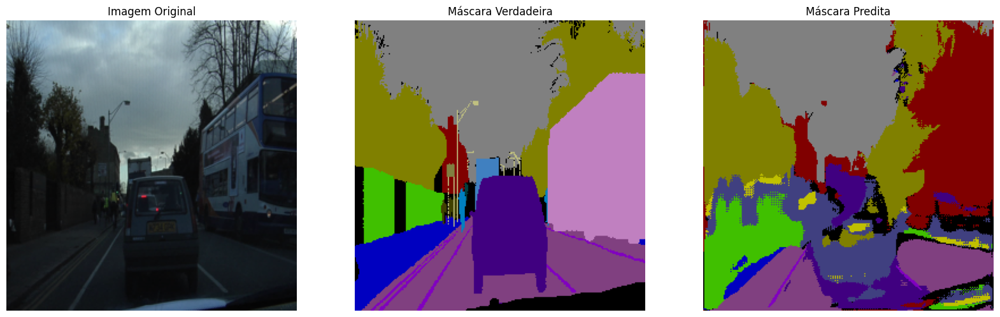

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 19.42s - Train Loss: 0.5379 | Val Loss: 0.5683 | Val IoU: 0.2123


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 19.44s - Train Loss: 0.5287 | Val Loss: 0.5872 | Val IoU: 0.2292


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 19.33s - Train Loss: 0.4937 | Val Loss: 0.6583 | Val IoU: 0.2122


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 19.65s - Train Loss: 0.4953 | Val Loss: 0.7128 | Val IoU: 0.1916


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 19.43s - Train Loss: 0.4702 | Val Loss: 0.5084 | Val IoU: 0.2614


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 19.19s - Train Loss: 0.4394 | Val Loss: 0.4939 | Val IoU: 0.2541


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 19.36s - Train Loss: 0.4076 | Val Loss: 0.5628 | Val IoU: 0.2658


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 19.37s - Train Loss: 0.4097 | Val Loss: 0.4964 | Val IoU: 0.2770


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 19.70s - Train Loss: 0.3690 | Val Loss: 0.4721 | Val IoU: 0.2840


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 19.76s - Train Loss: 0.3748 | Val Loss: 0.7730 | Val IoU: 0.2230


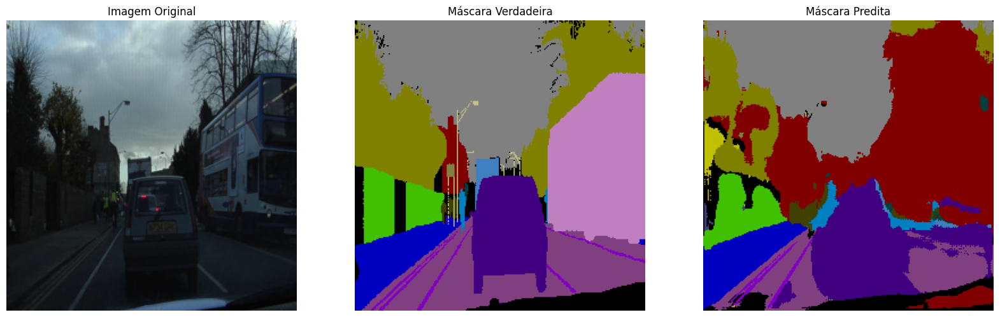

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 19.19s - Train Loss: 0.5318 | Val Loss: 0.5970 | Val IoU: 0.2539


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 19.51s - Train Loss: 0.4226 | Val Loss: 0.5097 | Val IoU: 0.2722


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 19.30s - Train Loss: 0.3672 | Val Loss: 0.4995 | Val IoU: 0.2950


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 19.10s - Train Loss: 0.3931 | Val Loss: 0.4586 | Val IoU: 0.3056


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 19.28s - Train Loss: 0.3320 | Val Loss: 0.4412 | Val IoU: 0.3151


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 18.94s - Train Loss: 0.3167 | Val Loss: 0.4785 | Val IoU: 0.3149


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 19.87s - Train Loss: 0.3051 | Val Loss: 0.4373 | Val IoU: 0.3333


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 19.98s - Train Loss: 0.3058 | Val Loss: 0.4578 | Val IoU: 0.3091


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 19.70s - Train Loss: 0.3133 | Val Loss: 0.4476 | Val IoU: 0.3224


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 19.69s - Train Loss: 0.2889 | Val Loss: 0.4138 | Val IoU: 0.3484


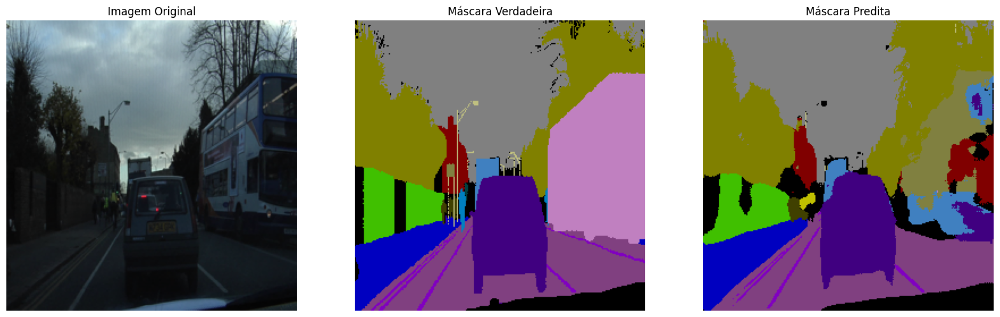

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 19.53s - Train Loss: 0.2710 | Val Loss: 0.4148 | Val IoU: 0.3334


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 19.51s - Train Loss: 0.2508 | Val Loss: 0.4309 | Val IoU: 0.3394


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 19.39s - Train Loss: 0.2468 | Val Loss: 0.3992 | Val IoU: 0.3517


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 20.21s - Train Loss: 0.2398 | Val Loss: 0.4072 | Val IoU: 0.3536


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 19.50s - Train Loss: 0.2288 | Val Loss: 0.4255 | Val IoU: 0.3477


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 19.21s - Train Loss: 0.2270 | Val Loss: 0.4940 | Val IoU: 0.3243


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 19.75s - Train Loss: 0.2491 | Val Loss: 0.6396 | Val IoU: 0.3016


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 19.60s - Train Loss: 0.3175 | Val Loss: 0.5180 | Val IoU: 0.3306


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 19.64s - Train Loss: 0.2414 | Val Loss: 0.3902 | Val IoU: 0.3670


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 19.60s - Train Loss: 0.2248 | Val Loss: 0.5791 | Val IoU: 0.3316


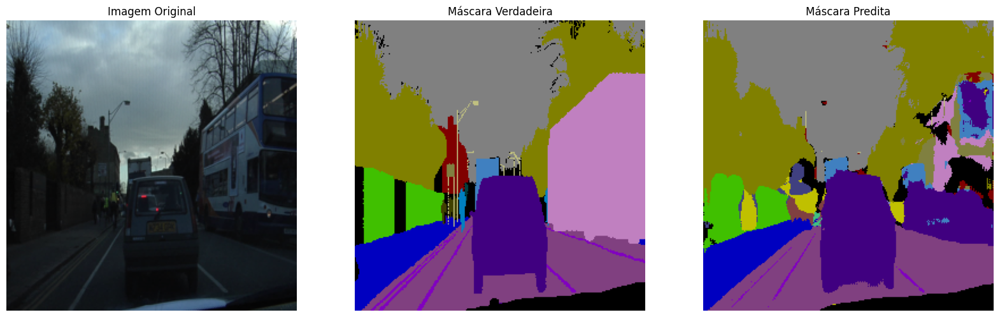

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 19.63s - Train Loss: 0.2665 | Val Loss: 0.4483 | Val IoU: 0.3348


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 19.99s - Train Loss: 0.2166 | Val Loss: 0.4015 | Val IoU: 0.3788


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [43/50] - Tempo: 19.19s - Train Loss: 0.1979 | Val Loss: 0.3950 | Val IoU: 0.3799


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [44/50] - Tempo: 19.70s - Train Loss: 0.2001 | Val Loss: 0.4256 | Val IoU: 0.3691


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [45/50] - Tempo: 19.32s - Train Loss: 0.2401 | Val Loss: 0.5395 | Val IoU: 0.3318


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [46/50] - Tempo: 19.24s - Train Loss: 0.2818 | Val Loss: 0.4275 | Val IoU: 0.3586


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [47/50] - Tempo: 19.31s - Train Loss: 0.2129 | Val Loss: 0.4017 | Val IoU: 0.3694


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [48/50] - Tempo: 19.41s - Train Loss: 0.1882 | Val Loss: 0.3979 | Val IoU: 0.3788


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [49/50] - Tempo: 19.14s - Train Loss: 0.1826 | Val Loss: 0.3811 | Val IoU: 0.3961


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [50/50] - Tempo: 19.22s - Train Loss: 0.1746 | Val Loss: 0.4019 | Val IoU: 0.3848


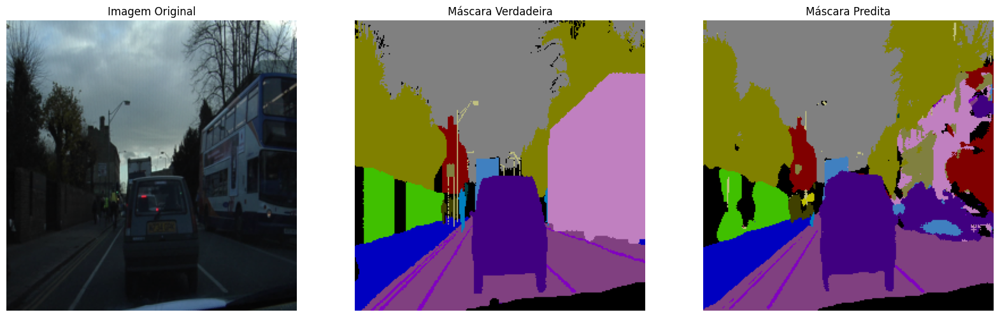

Treinamento finalizado. Carregando o melhor modelo encontrado...
[SALVOS] runs/SGD_CE___D4_F64__20250915-031031__last.pth  |  runs/SGD_CE___D4_F64__20250915-031031__best.pth
Fim do teste 'SGD+CE | D4 F64'. Limpando memória da GPU...

INICIANDO TESTE: SGD+CE | D3 F64
Parâmetros: {'nome_teste': 'SGD+CE | D3 F64', 'optimizer': 'SGD', 'loss_fn': 'CrossEntropyLoss', 'lr': 0.015, 'batch_size': 16, 'depth': 3, 'features': 64}


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 18.32s - Train Loss: 2.1129 | Val Loss: 1.9992 | Val IoU: 0.0462


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 18.52s - Train Loss: 1.2779 | Val Loss: 1.2682 | Val IoU: 0.0798


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 18.48s - Train Loss: 1.0890 | Val Loss: 1.2272 | Val IoU: 0.0936


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 18.43s - Train Loss: 1.0498 | Val Loss: 1.2345 | Val IoU: 0.0888


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 18.57s - Train Loss: 0.9671 | Val Loss: 1.4293 | Val IoU: 0.0849


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 18.55s - Train Loss: 0.8806 | Val Loss: 0.9591 | Val IoU: 0.1236


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 18.50s - Train Loss: 0.8255 | Val Loss: 1.2161 | Val IoU: 0.1138


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 18.43s - Train Loss: 0.7815 | Val Loss: 0.8104 | Val IoU: 0.1505


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 18.25s - Train Loss: 0.7762 | Val Loss: 0.9497 | Val IoU: 0.1439


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 18.80s - Train Loss: 0.7637 | Val Loss: 0.7952 | Val IoU: 0.1594


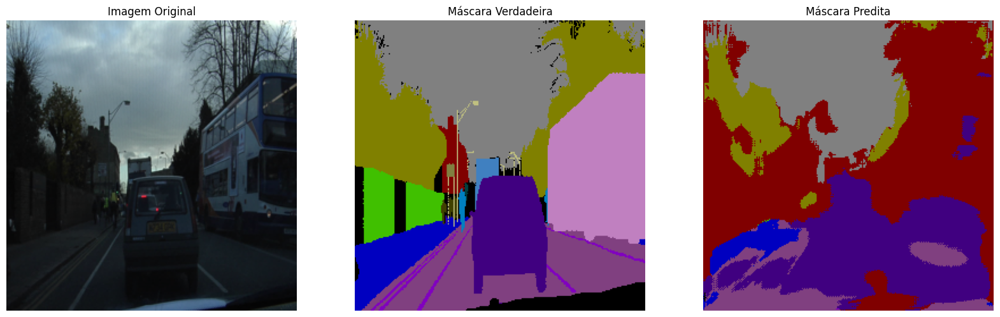

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 18.78s - Train Loss: 0.7041 | Val Loss: 0.6835 | Val IoU: 0.1740


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 19.02s - Train Loss: 0.6531 | Val Loss: 0.6754 | Val IoU: 0.1819


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 18.05s - Train Loss: 0.6714 | Val Loss: 0.8385 | Val IoU: 0.1673


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 18.67s - Train Loss: 0.7045 | Val Loss: 0.7622 | Val IoU: 0.1647


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 18.54s - Train Loss: 0.6437 | Val Loss: 0.7737 | Val IoU: 0.1676


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 18.31s - Train Loss: 0.6001 | Val Loss: 0.6500 | Val IoU: 0.1918


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 18.38s - Train Loss: 0.5712 | Val Loss: 0.6335 | Val IoU: 0.1940


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 18.29s - Train Loss: 0.5540 | Val Loss: 0.6769 | Val IoU: 0.1922


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 18.29s - Train Loss: 0.5702 | Val Loss: 0.7429 | Val IoU: 0.1822


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 18.19s - Train Loss: 0.5859 | Val Loss: 0.6877 | Val IoU: 0.1934


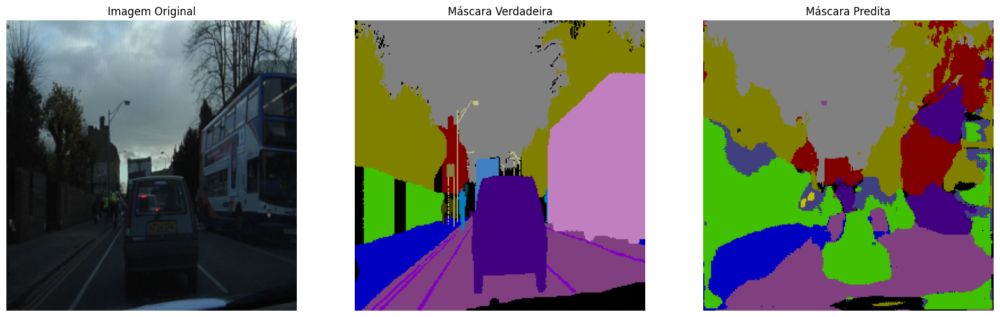

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 18.26s - Train Loss: 0.5805 | Val Loss: 0.6732 | Val IoU: 0.2039


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 18.18s - Train Loss: 0.5464 | Val Loss: 0.6777 | Val IoU: 0.2082


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 18.80s - Train Loss: 0.5222 | Val Loss: 0.6364 | Val IoU: 0.2093


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 18.44s - Train Loss: 0.4847 | Val Loss: 0.5473 | Val IoU: 0.2383


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 18.60s - Train Loss: 0.4804 | Val Loss: 0.5281 | Val IoU: 0.2509


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 18.61s - Train Loss: 0.4554 | Val Loss: 0.5752 | Val IoU: 0.2411


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 18.34s - Train Loss: 0.4844 | Val Loss: 0.7190 | Val IoU: 0.2139


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 18.60s - Train Loss: 0.5406 | Val Loss: 0.9258 | Val IoU: 0.1955


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 18.62s - Train Loss: 0.5251 | Val Loss: 0.7210 | Val IoU: 0.1986


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 18.22s - Train Loss: 0.4931 | Val Loss: 0.6254 | Val IoU: 0.2281


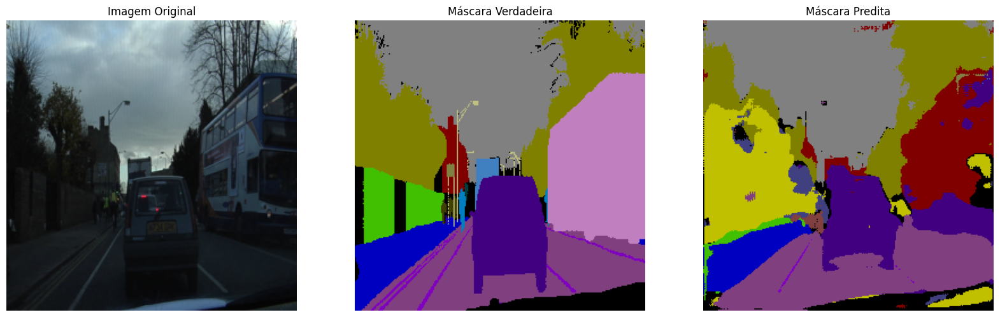

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 18.48s - Train Loss: 0.4705 | Val Loss: 0.5072 | Val IoU: 0.2585


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 18.66s - Train Loss: 0.4433 | Val Loss: 0.5144 | Val IoU: 0.2766


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 18.20s - Train Loss: 0.4564 | Val Loss: 0.6462 | Val IoU: 0.2318


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 18.41s - Train Loss: 0.4527 | Val Loss: 0.5463 | Val IoU: 0.2512


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 19.02s - Train Loss: 0.4619 | Val Loss: 0.6238 | Val IoU: 0.2524


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 17.97s - Train Loss: 0.4430 | Val Loss: 0.4839 | Val IoU: 0.2864


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 18.67s - Train Loss: 0.3906 | Val Loss: 0.5190 | Val IoU: 0.2746


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 18.61s - Train Loss: 0.3896 | Val Loss: 0.5130 | Val IoU: 0.2922


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 18.43s - Train Loss: 0.3693 | Val Loss: 0.4405 | Val IoU: 0.3131


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 18.55s - Train Loss: 0.3860 | Val Loss: 0.6632 | Val IoU: 0.2391


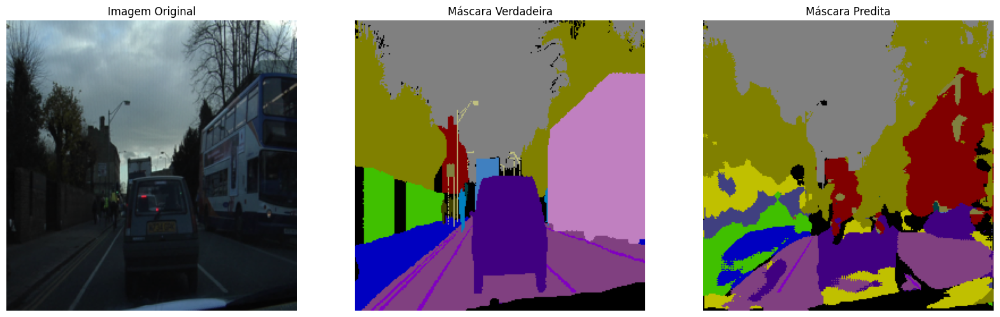

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 18.54s - Train Loss: 0.4323 | Val Loss: 0.7551 | Val IoU: 0.2657


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 18.65s - Train Loss: 0.4242 | Val Loss: 0.5578 | Val IoU: 0.2642


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [43/50] - Tempo: 19.10s - Train Loss: 0.4003 | Val Loss: 0.5717 | Val IoU: 0.2816


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [44/50] - Tempo: 18.22s - Train Loss: 0.3713 | Val Loss: 0.4777 | Val IoU: 0.3012


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [45/50] - Tempo: 18.70s - Train Loss: 0.3424 | Val Loss: 0.4407 | Val IoU: 0.3235


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [46/50] - Tempo: 18.30s - Train Loss: 0.3316 | Val Loss: 0.4803 | Val IoU: 0.3092


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [47/50] - Tempo: 18.61s - Train Loss: 0.3772 | Val Loss: 0.4869 | Val IoU: 0.3050


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [48/50] - Tempo: 18.15s - Train Loss: 0.3696 | Val Loss: 0.5210 | Val IoU: 0.2942


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [49/50] - Tempo: 18.55s - Train Loss: 0.3431 | Val Loss: 0.4868 | Val IoU: 0.2939
--- PARADA ANTECIPADA NA EPOCH 49 ---
Treinamento finalizado. Carregando o melhor modelo encontrado...
[SALVOS] runs/SGD_CE___D3_F64__20250915-032550__last.pth  |  runs/SGD_CE___D3_F64__20250915-032550__best.pth
Fim do teste 'SGD+CE | D3 F64'. Limpando memória da GPU...

INICIANDO TESTE: Adam+CE | D4 F64
Parâmetros: {'nome_teste': 'Adam+CE | D4 F64', 'optimizer': 'Adam', 'loss_fn': 'CrossEntropyLoss', 'lr': 0.0003, 'batch_size': 8, 'depth': 4, 'features': 64}


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 18.94s - Train Loss: 2.3919 | Val Loss: 1.8420 | Val IoU: 0.0851


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 18.98s - Train Loss: 1.6102 | Val Loss: 1.3208 | Val IoU: 0.1190


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 18.99s - Train Loss: 1.2492 | Val Loss: 1.1720 | Val IoU: 0.1305


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 19.42s - Train Loss: 1.0323 | Val Loss: 0.9232 | Val IoU: 0.1531


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 19.35s - Train Loss: 0.9039 | Val Loss: 0.8676 | Val IoU: 0.1558


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 19.12s - Train Loss: 0.8177 | Val Loss: 0.8444 | Val IoU: 0.1549


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 18.96s - Train Loss: 0.7812 | Val Loss: 0.7326 | Val IoU: 0.1758


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 19.20s - Train Loss: 0.7343 | Val Loss: 0.7080 | Val IoU: 0.1860


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 19.00s - Train Loss: 0.6850 | Val Loss: 0.6843 | Val IoU: 0.1919


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 19.27s - Train Loss: 0.6424 | Val Loss: 0.6830 | Val IoU: 0.2011


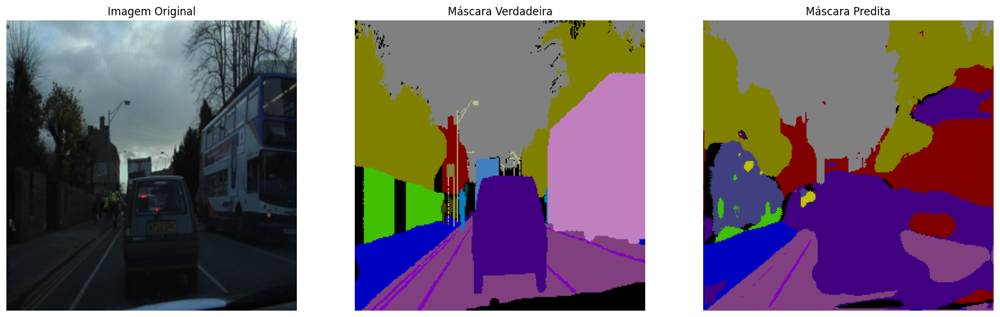

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 19.09s - Train Loss: 0.6335 | Val Loss: 0.6386 | Val IoU: 0.2051


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 19.16s - Train Loss: 0.5789 | Val Loss: 0.6478 | Val IoU: 0.1982


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 19.34s - Train Loss: 0.6022 | Val Loss: 0.7747 | Val IoU: 0.1956


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 19.38s - Train Loss: 0.5584 | Val Loss: 0.5587 | Val IoU: 0.2323


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 18.98s - Train Loss: 0.5379 | Val Loss: 0.5544 | Val IoU: 0.2281


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 19.28s - Train Loss: 0.5408 | Val Loss: 0.5812 | Val IoU: 0.2333


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 19.10s - Train Loss: 0.5426 | Val Loss: 0.6615 | Val IoU: 0.2273


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 19.36s - Train Loss: 0.5048 | Val Loss: 0.6433 | Val IoU: 0.2314


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 18.87s - Train Loss: 0.4838 | Val Loss: 0.5362 | Val IoU: 0.2451


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 19.13s - Train Loss: 0.4658 | Val Loss: 0.5551 | Val IoU: 0.2587


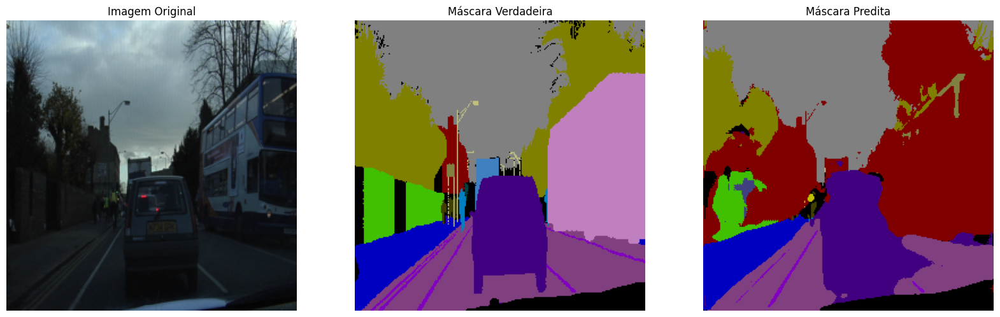

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 19.51s - Train Loss: 0.4655 | Val Loss: 0.4945 | Val IoU: 0.2719


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 19.31s - Train Loss: 0.4458 | Val Loss: 0.4972 | Val IoU: 0.2857


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 19.12s - Train Loss: 0.4265 | Val Loss: 0.4765 | Val IoU: 0.2826


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 19.10s - Train Loss: 0.4048 | Val Loss: 0.4643 | Val IoU: 0.2978


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 19.47s - Train Loss: 0.4154 | Val Loss: 0.4745 | Val IoU: 0.2927


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 19.38s - Train Loss: 0.3960 | Val Loss: 0.4708 | Val IoU: 0.3088


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 19.25s - Train Loss: 0.3824 | Val Loss: 0.5308 | Val IoU: 0.2790


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 19.11s - Train Loss: 0.4930 | Val Loss: 0.5490 | Val IoU: 0.2728


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 19.31s - Train Loss: 0.4307 | Val Loss: 0.5116 | Val IoU: 0.2975


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 19.62s - Train Loss: 0.3789 | Val Loss: 0.4423 | Val IoU: 0.3173


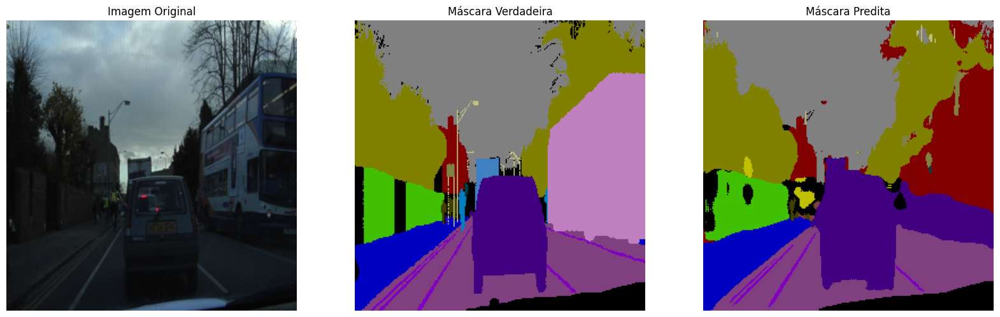

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 19.27s - Train Loss: 0.3798 | Val Loss: 0.4529 | Val IoU: 0.2949


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 19.17s - Train Loss: 0.4078 | Val Loss: 0.4403 | Val IoU: 0.3107


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 19.41s - Train Loss: 0.3609 | Val Loss: 0.4150 | Val IoU: 0.3321


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 19.58s - Train Loss: 0.3377 | Val Loss: 0.4396 | Val IoU: 0.3233


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 19.14s - Train Loss: 0.3312 | Val Loss: 0.4261 | Val IoU: 0.3325


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 19.30s - Train Loss: 0.3540 | Val Loss: 0.4187 | Val IoU: 0.3353


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 18.98s - Train Loss: 0.3341 | Val Loss: 0.4128 | Val IoU: 0.3428


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 19.32s - Train Loss: 0.3460 | Val Loss: 0.4189 | Val IoU: 0.3393


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 19.56s - Train Loss: 0.3494 | Val Loss: 0.5378 | Val IoU: 0.3068


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 19.15s - Train Loss: 0.3855 | Val Loss: 0.4439 | Val IoU: 0.3243


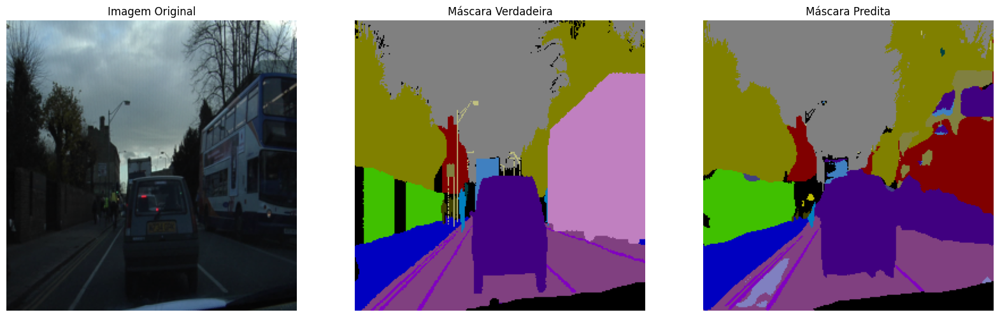

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 19.66s - Train Loss: 0.3408 | Val Loss: 0.4192 | Val IoU: 0.3392


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 19.20s - Train Loss: 0.3112 | Val Loss: 0.4106 | Val IoU: 0.3358


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [43/50] - Tempo: 19.56s - Train Loss: 0.3084 | Val Loss: 0.4265 | Val IoU: 0.3460


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [44/50] - Tempo: 19.16s - Train Loss: 0.3187 | Val Loss: 0.3993 | Val IoU: 0.3490


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [45/50] - Tempo: 19.50s - Train Loss: 0.2894 | Val Loss: 0.3841 | Val IoU: 0.3623


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [46/50] - Tempo: 19.30s - Train Loss: 0.2797 | Val Loss: 0.4030 | Val IoU: 0.3493


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [47/50] - Tempo: 19.31s - Train Loss: 0.2827 | Val Loss: 0.3849 | Val IoU: 0.3669


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [48/50] - Tempo: 19.13s - Train Loss: 0.2840 | Val Loss: 0.3900 | Val IoU: 0.3592


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [49/50] - Tempo: 19.44s - Train Loss: 0.2724 | Val Loss: 0.3951 | Val IoU: 0.3612


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [50/50] - Tempo: 19.44s - Train Loss: 0.3013 | Val Loss: 0.4051 | Val IoU: 0.3583


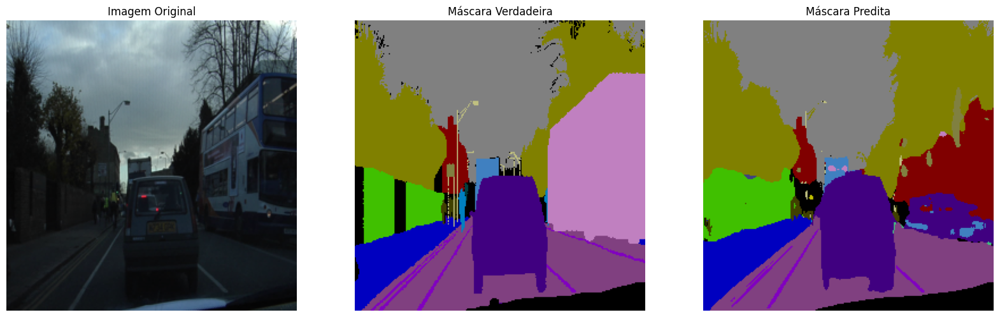

Treinamento finalizado. Carregando o melhor modelo encontrado...
[SALVOS] runs/Adam_CE___D4_F64__20250915-034209__last.pth  |  runs/Adam_CE___D4_F64__20250915-034209__best.pth
Fim do teste 'Adam+CE | D4 F64'. Limpando memória da GPU...

INICIANDO TESTE: Adam+Dice | D4 F32
Parâmetros: {'nome_teste': 'Adam+Dice | D4 F32', 'optimizer': 'Adam', 'loss_fn': 'DiceLoss', 'lr': 0.001, 'batch_size': 16, 'depth': 4, 'features': 32}


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 17.60s - Train Loss: 0.8569 | Val Loss: 0.6380 | Val IoU: 0.0551


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 17.93s - Train Loss: 0.7537 | Val Loss: 0.7052 | Val IoU: 0.0422


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 17.39s - Train Loss: 0.6527 | Val Loss: 0.7422 | Val IoU: 0.0521


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 17.24s - Train Loss: 0.5262 | Val Loss: 0.5252 | Val IoU: 0.0749


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 17.72s - Train Loss: 0.4460 | Val Loss: 0.4027 | Val IoU: 0.0759


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 17.80s - Train Loss: 0.3886 | Val Loss: 0.3847 | Val IoU: 0.0836


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 18.07s - Train Loss: 0.3496 | Val Loss: 0.3879 | Val IoU: 0.0795


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 17.74s - Train Loss: 0.3181 | Val Loss: 0.3346 | Val IoU: 0.0813


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 17.34s - Train Loss: 0.3079 | Val Loss: 0.4112 | Val IoU: 0.0733


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 17.52s - Train Loss: 0.2912 | Val Loss: 0.2953 | Val IoU: 0.1116


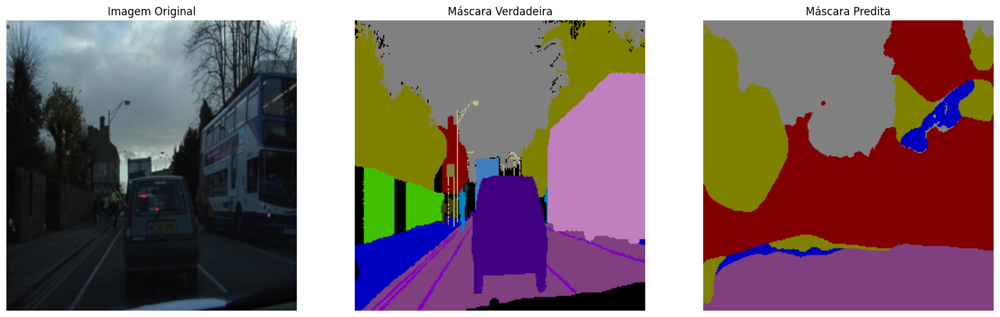

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 17.88s - Train Loss: 0.2629 | Val Loss: 0.2646 | Val IoU: 0.1102


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 17.84s - Train Loss: 0.2404 | Val Loss: 0.2553 | Val IoU: 0.1116


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 17.84s - Train Loss: 0.2368 | Val Loss: 0.2528 | Val IoU: 0.1110


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 17.39s - Train Loss: 0.2331 | Val Loss: 0.2497 | Val IoU: 0.1133


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 17.12s - Train Loss: 0.2344 | Val Loss: 0.2335 | Val IoU: 0.1177


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 17.71s - Train Loss: 0.2245 | Val Loss: 0.2247 | Val IoU: 0.1191


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 17.99s - Train Loss: 0.2277 | Val Loss: 0.2227 | Val IoU: 0.1200


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 17.64s - Train Loss: 0.2261 | Val Loss: 0.2913 | Val IoU: 0.1030


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 17.91s - Train Loss: 0.2206 | Val Loss: 0.2175 | Val IoU: 0.1206


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 17.57s - Train Loss: 0.2260 | Val Loss: 0.2230 | Val IoU: 0.1204


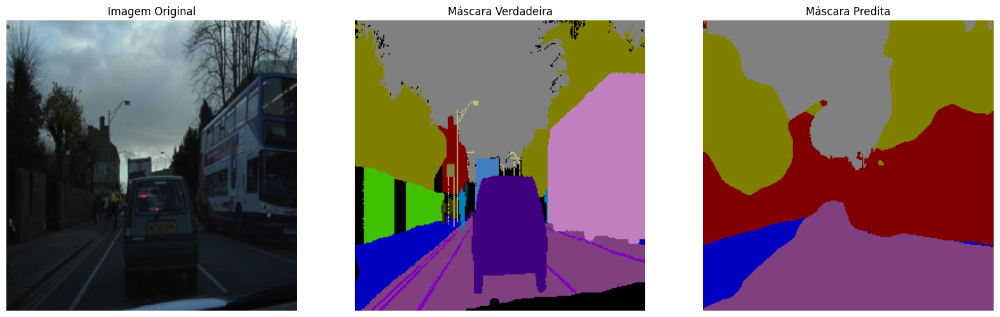

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 17.69s - Train Loss: 0.2139 | Val Loss: 0.2165 | Val IoU: 0.1220


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 17.38s - Train Loss: 0.2112 | Val Loss: 0.2148 | Val IoU: 0.1205


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 18.20s - Train Loss: 0.2174 | Val Loss: 0.2210 | Val IoU: 0.1195


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 17.91s - Train Loss: 0.2157 | Val Loss: 0.2268 | Val IoU: 0.1197


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 17.30s - Train Loss: 0.2085 | Val Loss: 0.2095 | Val IoU: 0.1228


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 17.35s - Train Loss: 0.2063 | Val Loss: 0.2088 | Val IoU: 0.1234


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 17.88s - Train Loss: 0.2081 | Val Loss: 0.2064 | Val IoU: 0.1238


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 17.77s - Train Loss: 0.2055 | Val Loss: 0.2316 | Val IoU: 0.1176


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 17.29s - Train Loss: 0.2037 | Val Loss: 0.2046 | Val IoU: 0.1229


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 17.46s - Train Loss: 0.1994 | Val Loss: 0.2078 | Val IoU: 0.1241


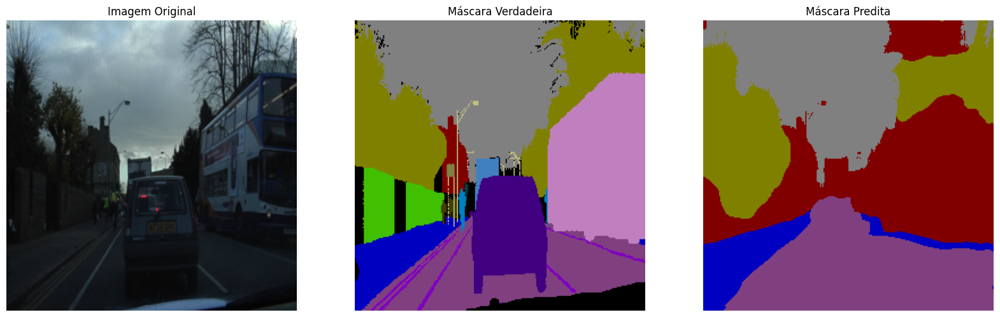

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 17.67s - Train Loss: 0.2114 | Val Loss: 0.2197 | Val IoU: 0.1189


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 17.37s - Train Loss: 0.2114 | Val Loss: 0.2168 | Val IoU: 0.1214


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 17.36s - Train Loss: 0.2093 | Val Loss: 0.2268 | Val IoU: 0.1168


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 17.81s - Train Loss: 0.2069 | Val Loss: 0.2113 | Val IoU: 0.1220


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 17.48s - Train Loss: 0.2037 | Val Loss: 0.2078 | Val IoU: 0.1232


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 17.50s - Train Loss: 0.2053 | Val Loss: 0.2135 | Val IoU: 0.1226


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 17.35s - Train Loss: 0.1996 | Val Loss: 0.2120 | Val IoU: 0.1217


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 17.26s - Train Loss: 0.2025 | Val Loss: 0.2019 | Val IoU: 0.1250


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 17.68s - Train Loss: 0.2022 | Val Loss: 0.2063 | Val IoU: 0.1228


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 17.48s - Train Loss: 0.2176 | Val Loss: 0.2116 | Val IoU: 0.1212


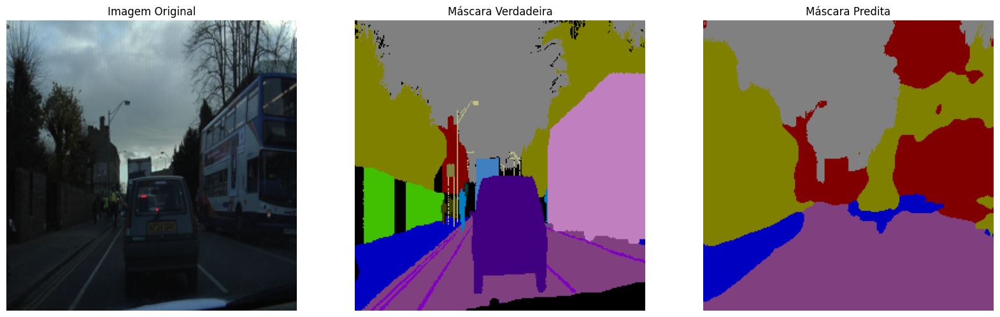

Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 17.00s - Train Loss: 0.2126 | Val Loss: 0.2061 | Val IoU: 0.1249


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 17.53s - Train Loss: 0.1990 | Val Loss: 0.2065 | Val IoU: 0.1236


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [43/50] - Tempo: 18.22s - Train Loss: 0.1939 | Val Loss: 0.1999 | Val IoU: 0.1249


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [44/50] - Tempo: 17.54s - Train Loss: 0.1938 | Val Loss: 0.1979 | Val IoU: 0.1262


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [45/50] - Tempo: 17.48s - Train Loss: 0.1971 | Val Loss: 0.1985 | Val IoU: 0.1258


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [46/50] - Tempo: 17.50s - Train Loss: 0.1990 | Val Loss: 0.2002 | Val IoU: 0.1271


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [47/50] - Tempo: 17.59s - Train Loss: 0.2135 | Val Loss: 0.2242 | Val IoU: 0.1186


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [48/50] - Tempo: 17.89s - Train Loss: 0.2029 | Val Loss: 0.2030 | Val IoU: 0.1243


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [49/50] - Tempo: 17.08s - Train Loss: 0.2000 | Val Loss: 0.2012 | Val IoU: 0.1238


Training:   0%|          | 0/24 [00:00<?, ?it/s]

Validation:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch [50/50] - Tempo: 17.38s - Train Loss: 0.2012 | Val Loss: 0.2077 | Val IoU: 0.1239


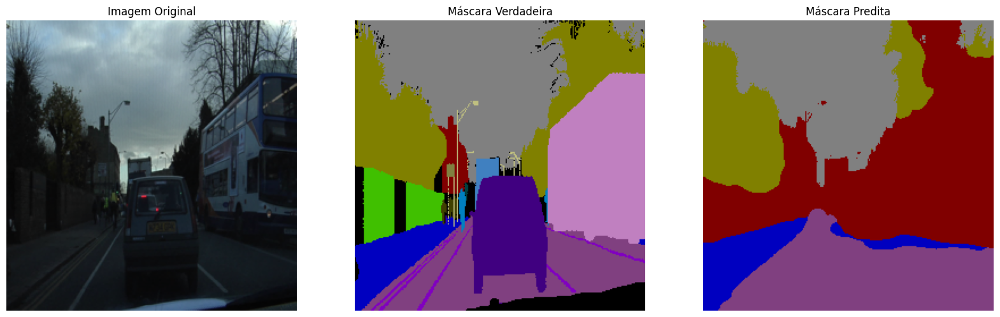

Treinamento finalizado. Carregando o melhor modelo encontrado...
[SALVOS] runs/Adam_Dice___D4_F32__20250915-035705__last.pth  |  runs/Adam_Dice___D4_F32__20250915-035705__best.pth
Fim do teste 'Adam+Dice | D4 F32'. Limpando memória da GPU...

Todos os testes foram concluídos!

Melhor experimento: 'Adam+Dice | D4 F32'
Menor Validation Loss: 0.1979
Modelo salvo com sucesso no arquivo 'overall_best_model.pth'

Gerando gráfico comparativo de resultados...


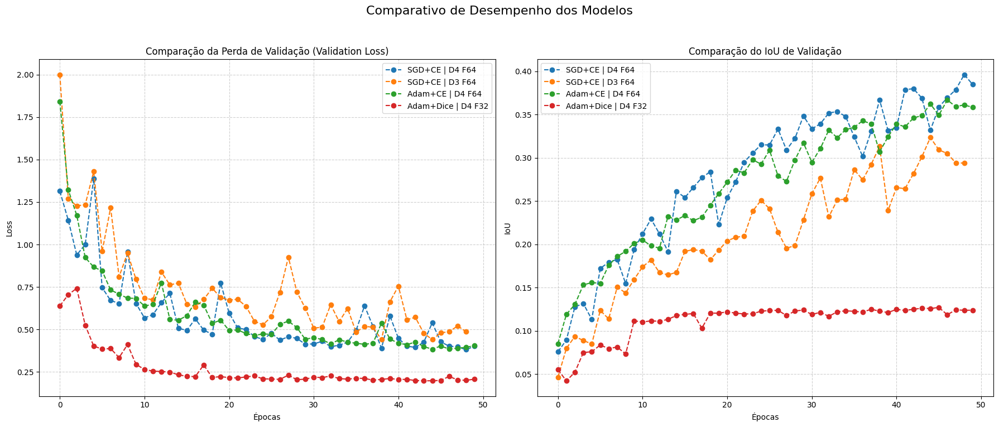

In [8]:
# =========================================================
#                 INÍCIO DO SCRIPT DE TREINO
# =========================================================

# Pra salvar todos os pesos 
os.makedirs("runs", exist_ok=True)
def _slug(s):
    return "".join(c if c.isalnum() or c in "-_ " else "_" for c in s).strip().replace(" ", "_")

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Usando o dispositivo: {DEVICE}")

# Lista de parâmetros
parametros_teste = [
    {
        "nome_teste": "SGD+CE | D4 F64",
        "optimizer": "SGD",
        "loss_fn": "CrossEntropyLoss",
        "lr": 0.01,
        "batch_size": 8,
        "depth": 4,
        "features": 64
    },
    {
        "nome_teste": "SGD+CE | D3 F64",
        "optimizer": "SGD",
        "loss_fn": "CrossEntropyLoss",
        "lr": 0.015,
        "batch_size": 16,
        "depth": 3,
        "features": 64
    },
    # --- Adam (converge rápido; bom para comparar) ---
    {
        "nome_teste": "Adam+CE | D4 F64",
        "optimizer": "Adam",
        "loss_fn": "CrossEntropyLoss",
        "lr": 3e-4,
        "batch_size": 8,
        "depth": 4,
        "features": 64
    },
    {
        "nome_teste": "Adam+Dice | D4 F32",
        "optimizer": "Adam",
        "loss_fn": "DiceLoss",
        "lr": 1e-3,
        "batch_size": 16,
        "depth": 4,
        "features": 32
    },
]

# Variáveis
EPOCHS = 50
PATIENCE = 10
resultados_gerais = {}
overall_best_val_loss = float('inf')
best_model_weights = None
best_experiment_name = ""

for params in parametros_teste:
    print("\n" + "="*50)
    print(f"INICIANDO TESTE: {params['nome_teste']}")
    print(f"Parâmetros: {params}")
    print("="*50)

    train_dataloader = DataLoader(train_dataset, batch_size=params['batch_size'], shuffle=True,  num_workers=2, pin_memory=True)
    val_dataloader   = DataLoader(val_dataset,   batch_size=params['batch_size'], shuffle=False, num_workers=2, pin_memory=True)

    model = UNet(
        in_channels=3,
        out_channels=num_classes,
        depth=params['depth'],
        features=params['features']
    ).to(DEVICE)

    # Função de Perda
    if params['loss_fn'] == 'CrossEntropyLoss':
        loss_fn = nn.CrossEntropyLoss()
    elif params['loss_fn'] == 'DiceLoss':
        loss_fn = DiceLoss()
    else:
        raise ValueError(f"Função de perda desconhecida: {params['loss_fn']}")

    # Otimizador
    if params['optimizer'] == 'Adam':
        optimizer = optim.Adam(model.parameters(), lr=params['lr'])
    elif params['optimizer'] == 'SGD':
        optimizer = optim.SGD(model.parameters(), lr=params['lr'], momentum=0.9)
    else:
        raise ValueError(f"Otimizador desconhecido: {params['optimizer']}")

    trainer = Trainer(
        model=model,
        train_loader=train_dataloader,
        val_loader=val_dataloader,
        optimizer=optimizer,
        loss_fn=loss_fn,
        device=DEVICE,
        num_classes=num_classes
    )

    # Treino
    history = trainer.fit(EPOCHS, PATIENCE, color_map)
    resultados_gerais[params['nome_teste']] = history

    # Salva os pesos
    exp   = params['nome_teste']
    stamp = time.strftime("%Y%m%d-%H%M%S")
    slug  = _slug(exp)
    last_path = os.path.join("runs", f"{slug}__{stamp}__last.pth")
    torch.save(model.state_dict(), last_path)

    # Tenta salvar o melhor modelo
    best_state = model.state_dict()
    if os.path.exists("best_model.pth"):
        try:
            best_state = torch.load("best_model.pth", map_location="cpu")
        except Exception:
            best_state = model.state_dict()
        # evita conflito para o próximo run
        try:
            os.remove("best_model.pth")
        except Exception:
            pass

    best_path = os.path.join("runs", f"{slug}__{stamp}__best.pth")
    torch.save(best_state, best_path)
    print(f"[SALVOS] {last_path}  |  {best_path}")

    # --- Atualiza melhor global (opcional) ---
    min_val_loss_in_run = min(history['val_loss'])
    if min_val_loss_in_run < overall_best_val_loss:
        overall_best_val_loss = min_val_loss_in_run
        best_model_weights = best_state  # guarda o best deste run
        best_experiment_name = params['nome_teste']

    # --- Limpeza de memória ---
    print(f"Fim do teste '{params['nome_teste']}'. Limpando memória da GPU...")
    del model, optimizer, trainer, train_dataloader, val_dataloader
    gc.collect()
    if torch.cuda.is_available():
        torch.cuda.empty_cache()

print("\nTodos os testes foram concluídos!")

if best_model_weights is not None:
    print("\n" + "="*50)
    print(f"Melhor experimento: '{best_experiment_name}'")
    print(f"Menor Validation Loss: {overall_best_val_loss:.4f}")
    torch.save(best_model_weights, 'overall_best_model.pth')
    print("Modelo salvo com sucesso no arquivo 'overall_best_model.pth'")
    print("="*50)

if resultados_gerais:
    print("\nGerando gráfico comparativo de resultados...")
    plot_all_results(resultados_gerais)


In [9]:
# =========================================================
#                CARREGANDO O MELHOR MODELO
# =========================================================

# Fizemos alguns treinamentos com 100 épocas e vamos importar os pesos do melhor resultado ao invés de usar os resultados da célula anteior, 
# que foi feita para visualização
best_experiment_name = "Adam+CE | D4 F64"
best_params = next(p for p in parametros_teste if p['nome_teste'] == best_experiment_name)
print(f"\nParâmetros do melhor modelo ('{best_experiment_name}') encontrados:")
print(best_params)

# Criando o modelo
num_classes = len(color_map) # color_map deve estar na memória
model = UNet(
    in_channels=3, 
    out_channels=num_classes,
    depth=best_params['depth'],
    features=best_params['features']
).to(DEVICE)

# Carrega os pesos salvos
path = "/kaggle/input/adam-ce-d4-f64-potente-20250914-best/Adam_CE___D4_F64__potente___20250914-183031__best.pth"
model.load_state_dict(torch.load(path))
model.eval() # Coloca o modelo em modo de avaliação

print("Melhor modelo carregado com sucesso!")
val_dataloader = DataLoader(val_dataset, batch_size=best_params['batch_size'], shuffle=False, num_workers=2, pin_memory=True)


Parâmetros do melhor modelo ('Adam+CE | D4 F64') encontrados:
{'nome_teste': 'Adam+CE | D4 F64', 'optimizer': 'Adam', 'loss_fn': 'CrossEntropyLoss', 'lr': 0.0003, 'batch_size': 8, 'depth': 4, 'features': 64}
Melhor modelo carregado com sucesso!


#### Análise dos Erros de Predição do Modelo

Como podemos notar pelas imagens com pior desempenho e ainda mais pelo IoU geral das classes, o modelo aprendeu a estrutura geral da cena, segmentando bem áreas grandes e comuns como 'Céu', 'Estrada' e 'Prédios', mas falha consistentemente nos detalhes e na complexidade.

Os principais tipos de erro são:

* **Falha em Áreas Detalhadas e com Múltiplos Objetos:** O erro é maior em regiões complexas, especialmente onde múltiplos objetos de diferentes classes estão próximos e são pequenos, como ao lado de ruas. Notamos também que objetos pequenos e finos (como 'SignSymbol') possuem um IoU bem baixo. É comum que classes mais comums como 'Wall' dominem esses pequenos detalhes.

* **Imprecisão nas Bordas:** As previsões não possuem contornos nítidos. As bordas entre objetos distintos (ex: carro e asfalto, prédio e céu) são "borradas", o que prejudica severamente a métrica de IoU.

* **Ignorando Classes Pequenas:** O modelo tende a ignorar completamente classes com poucos pixels, como "Pedestre", classificando-as como a classe maior ao redor. Isso resulta em um IoU de zero para essas classes minoritárias.

Em resumo, o baixo IoU é um reflexo direto da incapacidade do modelo de lidar com a alta frequência de detalhes e a variedade de classes em cenas urbanas complexas, optando por uma segmentação grosseira baseada nas classes mais prevalentes.

In [10]:
# =========================================================
#            ANALISANDO DESEMPENHO DAS CLASSES
# =========================================================

print("\nCalculando IoU por classe no conjunto de validação...")
per_class_results = evaluate_per_class(model, val_dataloader, DEVICE, class_names)

# Split: IoU > 0 e IoU == 0 
eps = 1e-9
nonzero_df = per_class_results[per_class_results['iou'] > eps].sort_values(by='iou', ascending=False)
zero_df    = per_class_results[per_class_results['iou'] <= eps]

print("\n=== Classes com IoU > 0 (do maior pro menor) ===")
for _, row in nonzero_df.iterrows():
    print(f"{row['class_name']}: {row['iou']:.4f}")

print("\n=== Classes com IoU = 0 ===")
for name in zero_df['class_name'].tolist():
    print(name)


Calculando IoU por classe no conjunto de validação...


Avaliando por classe:   0%|          | 0/13 [00:00<?, ?it/s]


=== Classes com IoU > 0 (do maior pro menor) ===
Road: 0.9388
Sky: 0.9254
Building: 0.8683
Sidewalk: 0.8307
Tree: 0.7868
Car: 0.7639
VegetationMisc: 0.6683
LaneMkgsDriv: 0.6296
Wall: 0.6058
Bicyclist: 0.6031
TrafficLight: 0.5690
Fence: 0.5362
RoadShoulder: 0.4676
ParkingBlock: 0.3781
OtherMoving: 0.3760
Truck_Bus: 0.3596
Misc_Text: 0.3583
Pedestrian: 0.3269
SUVPickupTruck: 0.2839
Void: 0.2794
Column_Pole: 0.2239
SignSymbol: 0.1192

=== Classes com IoU = 0 ===
Animal
Archway
Bridge
CartLuggagePram
Child
LaneMkgsNonDriv
MotorcycleScooter
TrafficCone
Train
Tunnel


Calculando IoU por imagem:   0%|          | 0/100 [00:00<?, ?it/s]


--- Exibindo as 3 piores previsões ---


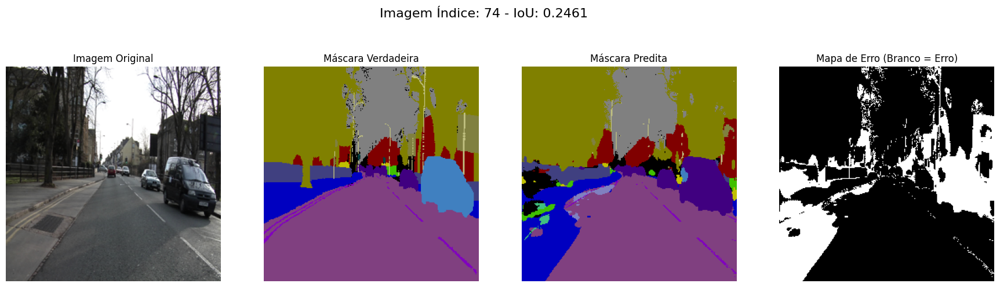

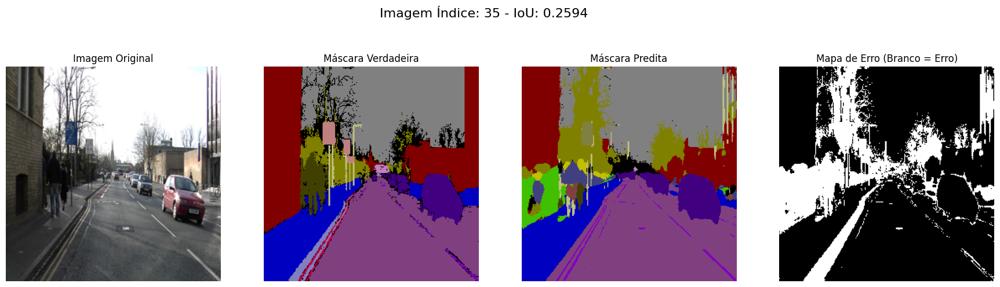

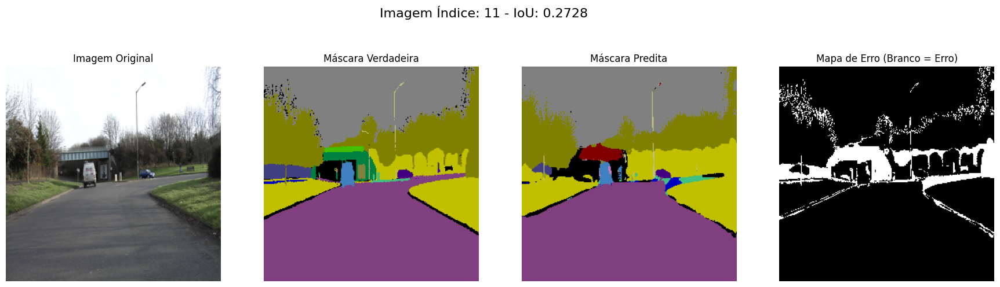

In [11]:
# =========================================================
#            ANALISANDO IMAGENS COM PIOR IoU
# =========================================================

# Função que encontra as piores predições de acordo com IoU
def find_and_plot_worst_images(model, dataset_subset, color_map, device, top_k=5):
    
    iou_metric = MulticlassJaccardIndex(num_classes=len(color_map)).to(device)
    image_scores = []

    # Calcula o IoU pra todas as imagens
    model.eval()
    with torch.no_grad():
        for i in tqdm(range(len(dataset_subset)), desc="Calculando IoU por imagem"):
            image, mask = dataset_subset[i]
            image_batch = image.unsqueeze(0).to(device, dtype=torch.float32)
            mask_batch = mask.unsqueeze(0).to(device, dtype=torch.long)
            prediction = model(image_batch)
            iou_metric.reset()
            iou_metric.update(prediction, mask_batch)
            iou_score = iou_metric.compute().item()
            image_scores.append({'index': i, 'iou': iou_score})

    worst_images = sorted(image_scores, key=lambda x: x['iou'])[:top_k]

    print(f"\n--- Exibindo as {top_k} piores previsões ---")
    
    # Plota os resultados das piores imagens
    for item in worst_images:
        idx = item['index']
        iou = item['iou']
        
        image_tensor, true_mask_tensor = dataset_subset[idx]
        image_batch = image_tensor.unsqueeze(0).to(device, dtype=torch.float32)
        
        with torch.no_grad():
            pred_tensor = model(image_batch)
            pred_mask_tensor = torch.argmax(pred_tensor, dim=1).squeeze(0) # Remove a dimensão do lote

        # Prepara para plotagem
        image_np = denormalize_img(image_tensor).permute(1, 2, 0).cpu().numpy()
        true_mask_np = true_mask_tensor.cpu().numpy()
        pred_mask_np = pred_mask_tensor.cpu().numpy()
        
        # Cria o mapa de erro (True onde há erro)
        error_map = (true_mask_np != pred_mask_np)
        
        # Converte máscaras para RGB
        true_mask_rgb = mask_to_rgb(true_mask_np, color_map)
        pred_mask_rgb = mask_to_rgb(pred_mask_np, color_map)
        
        # Plotagem
        fig, axes = plt.subplots(1, 4, figsize=(22, 6))
        fig.suptitle(f'Imagem Índice: {idx} - IoU: {iou:.4f}', fontsize=16)
        
        axes[0].imshow(image_np); axes[0].set_title("Imagem Original"); axes[0].axis('off')
        axes[1].imshow(true_mask_rgb); axes[1].set_title("Máscara Verdadeira"); axes[1].axis('off')
        axes[2].imshow(pred_mask_rgb); axes[2].set_title("Máscara Predita"); axes[2].axis('off')
        axes[3].imshow(error_map, cmap='gray'); axes[3].set_title("Mapa de Erro (Branco = Erro)"); axes[3].axis('off')
        
        plt.show()

find_and_plot_worst_images(model, val_dataset, color_map, DEVICE, top_k=3)

### Terceira Parte: Outras alternativas


INICIANDO TESTE: Adam+CE | D4 F64 (potente) | Com Augmentation


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 18.91s - Train Loss: 2.2195 | Val Loss: 1.7897 | Val IoU: 0.0767


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 19.27s - Train Loss: 1.5242 | Val Loss: 1.3177 | Val IoU: 0.1034


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 19.51s - Train Loss: 1.2271 | Val Loss: 1.1148 | Val IoU: 0.1249


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 19.49s - Train Loss: 1.0528 | Val Loss: 1.0543 | Val IoU: 0.1272


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 19.14s - Train Loss: 0.9507 | Val Loss: 0.9582 | Val IoU: 0.1362


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 19.32s - Train Loss: 0.8624 | Val Loss: 0.8562 | Val IoU: 0.1479


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 19.30s - Train Loss: 0.8209 | Val Loss: 0.8420 | Val IoU: 0.1537


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 19.87s - Train Loss: 0.7835 | Val Loss: 0.8507 | Val IoU: 0.1581


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 19.66s - Train Loss: 0.7485 | Val Loss: 0.7206 | Val IoU: 0.1716


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 19.79s - Train Loss: 0.6926 | Val Loss: 0.6512 | Val IoU: 0.1976


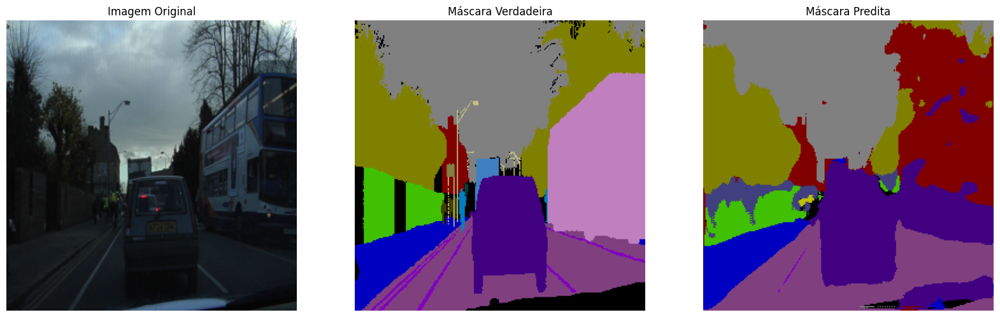

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 19.58s - Train Loss: 0.6606 | Val Loss: 0.6926 | Val IoU: 0.1911


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 19.26s - Train Loss: 0.6632 | Val Loss: 0.6248 | Val IoU: 0.2048


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 19.54s - Train Loss: 0.6066 | Val Loss: 0.6013 | Val IoU: 0.2071


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 19.66s - Train Loss: 0.5934 | Val Loss: 0.6589 | Val IoU: 0.2107


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 19.35s - Train Loss: 0.5812 | Val Loss: 0.5720 | Val IoU: 0.2366


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 19.26s - Train Loss: 0.5693 | Val Loss: 0.6423 | Val IoU: 0.2079


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 19.22s - Train Loss: 0.6056 | Val Loss: 0.6371 | Val IoU: 0.2196


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 18.95s - Train Loss: 0.5556 | Val Loss: 0.5618 | Val IoU: 0.2438


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 20.15s - Train Loss: 0.5328 | Val Loss: 0.5376 | Val IoU: 0.2482


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 19.75s - Train Loss: 0.5409 | Val Loss: 0.5313 | Val IoU: 0.2510


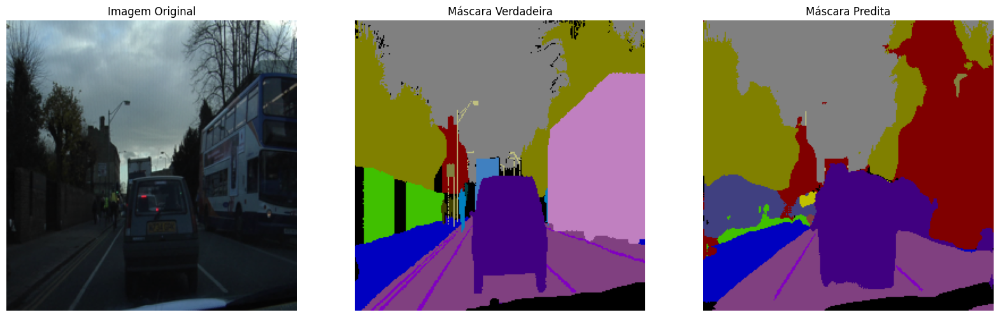

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 19.55s - Train Loss: 0.5101 | Val Loss: 0.5342 | Val IoU: 0.2531


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 19.49s - Train Loss: 0.4995 | Val Loss: 0.5538 | Val IoU: 0.2640


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 19.42s - Train Loss: 0.4948 | Val Loss: 0.5025 | Val IoU: 0.2689


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 19.71s - Train Loss: 0.4947 | Val Loss: 0.4897 | Val IoU: 0.2778


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 19.44s - Train Loss: 0.4634 | Val Loss: 0.4853 | Val IoU: 0.2796


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 19.67s - Train Loss: 0.4758 | Val Loss: 0.5478 | Val IoU: 0.2752


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 19.28s - Train Loss: 0.4320 | Val Loss: 0.4724 | Val IoU: 0.2823


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 19.60s - Train Loss: 0.4487 | Val Loss: 0.6610 | Val IoU: 0.2578


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 19.48s - Train Loss: 0.4857 | Val Loss: 0.4942 | Val IoU: 0.2706


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 19.43s - Train Loss: 0.4296 | Val Loss: 0.4747 | Val IoU: 0.2839


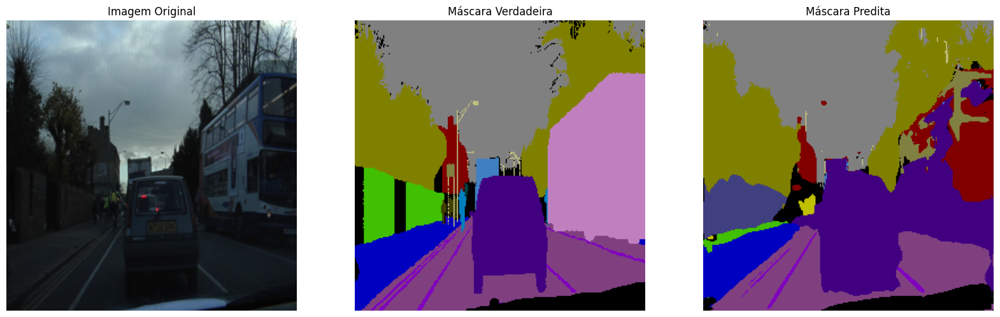

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 19.20s - Train Loss: 0.4099 | Val Loss: 0.4455 | Val IoU: 0.3014


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 19.32s - Train Loss: 0.4045 | Val Loss: 0.4451 | Val IoU: 0.2954


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 19.27s - Train Loss: 0.4087 | Val Loss: 0.4320 | Val IoU: 0.3086


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 19.36s - Train Loss: 0.4084 | Val Loss: 0.4372 | Val IoU: 0.3053


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 19.14s - Train Loss: 0.3879 | Val Loss: 0.4438 | Val IoU: 0.3082


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 19.38s - Train Loss: 0.4003 | Val Loss: 0.4877 | Val IoU: 0.2980


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 19.33s - Train Loss: 0.3788 | Val Loss: 0.4172 | Val IoU: 0.3221


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 19.69s - Train Loss: 0.3653 | Val Loss: 0.4108 | Val IoU: 0.3373


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 19.69s - Train Loss: 0.3599 | Val Loss: 0.4188 | Val IoU: 0.3213


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 19.76s - Train Loss: 0.3704 | Val Loss: 0.4608 | Val IoU: 0.3091


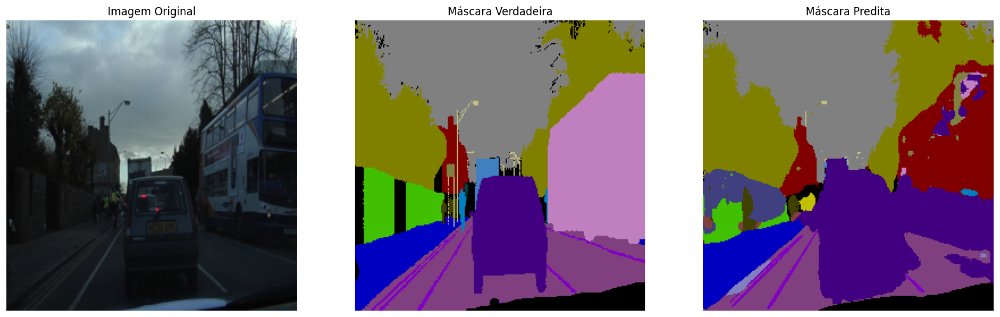

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 19.74s - Train Loss: 0.3911 | Val Loss: 0.4326 | Val IoU: 0.3305


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 19.57s - Train Loss: 0.3809 | Val Loss: 0.4033 | Val IoU: 0.3425


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [43/50] - Tempo: 19.41s - Train Loss: 0.3543 | Val Loss: 0.4104 | Val IoU: 0.3274


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [44/50] - Tempo: 19.50s - Train Loss: 0.3583 | Val Loss: 0.4129 | Val IoU: 0.3355


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [45/50] - Tempo: 19.55s - Train Loss: 0.3555 | Val Loss: 0.4203 | Val IoU: 0.3351


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [46/50] - Tempo: 19.38s - Train Loss: 0.3686 | Val Loss: 0.4273 | Val IoU: 0.3176


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [47/50] - Tempo: 19.55s - Train Loss: 0.3510 | Val Loss: 0.4302 | Val IoU: 0.3225
--- PARADA ANTECIPADA NA EPOCH 47 ---
Treinamento finalizado. Carregando o melhor modelo encontrado...

INICIANDO TESTE: Adam+CE | D4 F64 (potente) | Sem Augmentation


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 19.52s - Train Loss: 2.2006 | Val Loss: 1.7856 | Val IoU: 0.0739


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 19.40s - Train Loss: 1.5188 | Val Loss: 1.5579 | Val IoU: 0.0959


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 19.75s - Train Loss: 1.2064 | Val Loss: 1.1854 | Val IoU: 0.1217


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 19.50s - Train Loss: 1.0357 | Val Loss: 0.9977 | Val IoU: 0.1427


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 19.34s - Train Loss: 0.9181 | Val Loss: 0.8425 | Val IoU: 0.1492


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 19.20s - Train Loss: 0.8228 | Val Loss: 0.8312 | Val IoU: 0.1571


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 19.15s - Train Loss: 0.7833 | Val Loss: 0.8047 | Val IoU: 0.1551


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 19.57s - Train Loss: 0.7400 | Val Loss: 0.7944 | Val IoU: 0.1584


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 19.32s - Train Loss: 0.6874 | Val Loss: 0.6764 | Val IoU: 0.1869


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 19.29s - Train Loss: 0.6476 | Val Loss: 0.6496 | Val IoU: 0.1991


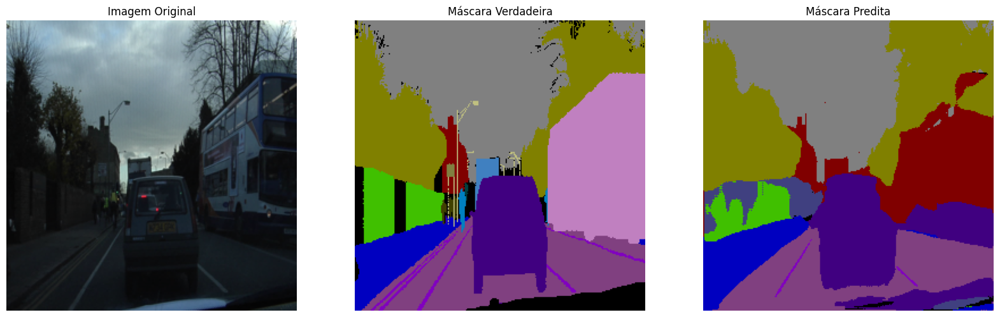

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 19.59s - Train Loss: 0.6500 | Val Loss: 0.7501 | Val IoU: 0.1832


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 19.62s - Train Loss: 0.6289 | Val Loss: 0.5967 | Val IoU: 0.2258


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 19.32s - Train Loss: 0.5860 | Val Loss: 0.5909 | Val IoU: 0.2219


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 19.92s - Train Loss: 0.5604 | Val Loss: 0.6512 | Val IoU: 0.2088


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 19.59s - Train Loss: 0.5430 | Val Loss: 0.5771 | Val IoU: 0.2325


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 19.23s - Train Loss: 0.5334 | Val Loss: 0.6511 | Val IoU: 0.2147


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 19.31s - Train Loss: 0.5243 | Val Loss: 0.5597 | Val IoU: 0.2403


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 19.38s - Train Loss: 0.4833 | Val Loss: 0.4988 | Val IoU: 0.2647


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 19.16s - Train Loss: 0.4665 | Val Loss: 0.4982 | Val IoU: 0.2653


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 19.63s - Train Loss: 0.4916 | Val Loss: 0.5581 | Val IoU: 0.2569


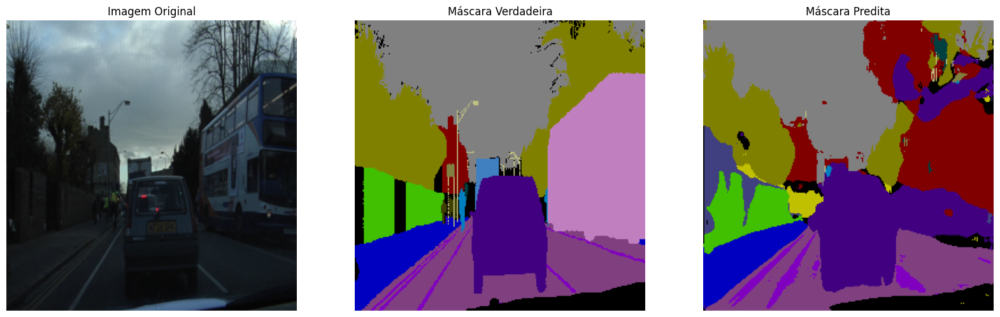

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 19.68s - Train Loss: 0.4624 | Val Loss: 0.5763 | Val IoU: 0.2350


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 19.27s - Train Loss: 0.5316 | Val Loss: 0.5277 | Val IoU: 0.2533


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 19.32s - Train Loss: 0.4756 | Val Loss: 0.5522 | Val IoU: 0.2580


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 19.35s - Train Loss: 0.4537 | Val Loss: 0.4635 | Val IoU: 0.2945


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 19.23s - Train Loss: 0.4139 | Val Loss: 0.4695 | Val IoU: 0.2888


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 19.45s - Train Loss: 0.4021 | Val Loss: 0.5426 | Val IoU: 0.2651


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 19.45s - Train Loss: 0.4655 | Val Loss: 0.5217 | Val IoU: 0.2811


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 19.29s - Train Loss: 0.4340 | Val Loss: 0.4489 | Val IoU: 0.3098


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 19.34s - Train Loss: 0.3932 | Val Loss: 0.4407 | Val IoU: 0.3120


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 19.10s - Train Loss: 0.3729 | Val Loss: 0.4739 | Val IoU: 0.2936


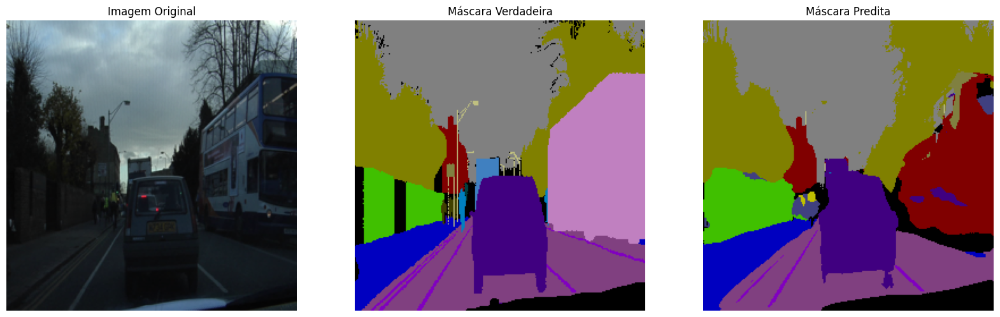

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 19.16s - Train Loss: 0.4348 | Val Loss: 0.4632 | Val IoU: 0.2997


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 19.20s - Train Loss: 0.3901 | Val Loss: 0.4360 | Val IoU: 0.3313


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 19.24s - Train Loss: 0.3618 | Val Loss: 0.4392 | Val IoU: 0.3080


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 19.04s - Train Loss: 0.3617 | Val Loss: 0.4490 | Val IoU: 0.3120


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 19.36s - Train Loss: 0.3933 | Val Loss: 0.4628 | Val IoU: 0.2942


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 19.35s - Train Loss: 0.3515 | Val Loss: 0.4045 | Val IoU: 0.3411


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 19.45s - Train Loss: 0.3314 | Val Loss: 0.4455 | Val IoU: 0.3150


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 19.08s - Train Loss: 0.3231 | Val Loss: 0.4078 | Val IoU: 0.3408


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 19.38s - Train Loss: 0.3218 | Val Loss: 0.4135 | Val IoU: 0.3432


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 19.71s - Train Loss: 0.3413 | Val Loss: 0.4064 | Val IoU: 0.3466


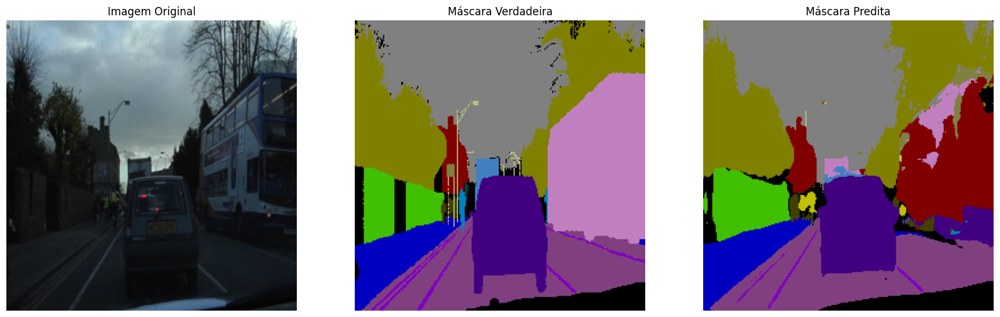

Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 19.22s - Train Loss: 0.3157 | Val Loss: 0.3889 | Val IoU: 0.3532


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 19.37s - Train Loss: 0.2999 | Val Loss: 0.3968 | Val IoU: 0.3430


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [43/50] - Tempo: 18.97s - Train Loss: 0.2830 | Val Loss: 0.4016 | Val IoU: 0.3515


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [44/50] - Tempo: 18.92s - Train Loss: 0.2945 | Val Loss: 0.4837 | Val IoU: 0.3421


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [45/50] - Tempo: 19.38s - Train Loss: 0.3544 | Val Loss: 0.4125 | Val IoU: 0.3489


Training:   0%|          | 0/47 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [46/50] - Tempo: 19.44s - Train Loss: 0.3151 | Val Loss: 1.1629 | Val IoU: 0.2817
--- PARADA ANTECIPADA NA EPOCH 46 ---
Treinamento finalizado. Carregando o melhor modelo encontrado...

Todos os testes de augmentation foram concluídos!


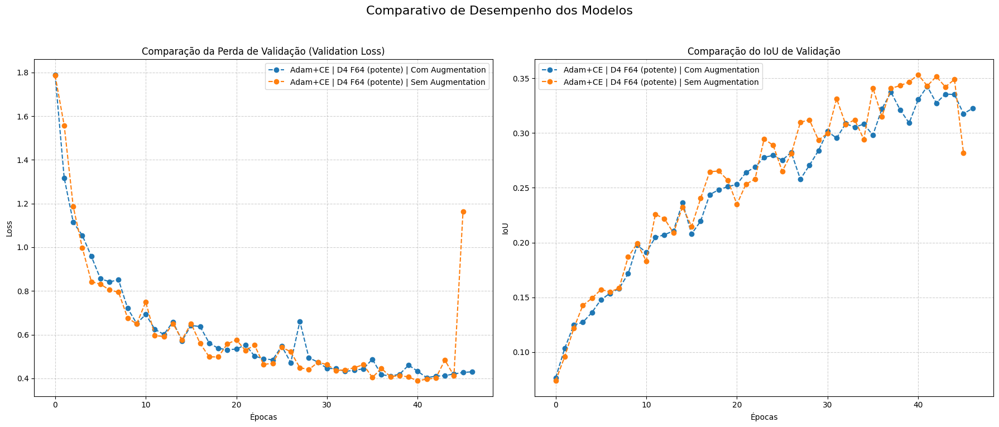

In [12]:
# =========================================================
#                DATA AUGMENTATION
# =========================================================

# Vamos usar a configuração do melhor modelo que encontramos
PARAMS = {
    "nome_base": "Adam+CE | D4 F64 (potente)",
    "optimizer": "Adam",
    "loss_fn": "CrossEntropyLoss",
    "lr": 3e-4,
    "batch_size": 8,
    "depth": 4,
    "features": 64
}

EPOCHS = 50
PATIENCE = 5
num_classes = len(color_map)
resultados_augmentation = {}

for use_augmentation in [True, False]:
    nome_teste = PARAMS['nome_base'] + (" | Com Augmentation" if use_augmentation else " | Sem Augmentation")
    print("\n" + "="*50)
    print(f"INICIANDO TESTE: {nome_teste}")
    print("="*50)

    # Datasets/Dataloaders
    train_dataset_exp = CamVidDataset(
        images_dir = "/kaggle/working/CamVid/train_256",
        masks_dir = "/kaggle/working/CamVid/train_labels_256",
        color_map = color_map,
        data_augmentation = use_augmentation
    )
    val_dataset_exp = CamVidDataset(
        images_dir = "/kaggle/working/CamVid/val_256",
        masks_dir = "/kaggle/working/CamVid/val_labels_256",
        color_map = color_map,
        data_augmentation = False # Data Augmentation só se usa no Treino
    )
    train_dataloader = DataLoader(train_dataset_exp, batch_size=PARAMS['batch_size'], shuffle=True,  num_workers=2, pin_memory=True)
    val_dataloader   = DataLoader(val_dataset_exp,   batch_size=PARAMS['batch_size'], shuffle=False, num_workers=2, pin_memory=True)

    # Modelo/otimizador/perda
    model = UNet(
        in_channels=3,
        out_channels=num_classes,
        depth=PARAMS['depth'],
        features=PARAMS['features']
    ).to(DEVICE)

    loss_fn  = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=PARAMS['lr'], weight_decay=PARAMS.get('weight_decay', 0))

    # Trainer
    trainer = Trainer(
        model=model,
        train_loader=train_dataloader,
        val_loader=val_dataloader,
        optimizer=optimizer,
        loss_fn=loss_fn,
        device=DEVICE,
        num_classes=num_classes
    )

    # Treino
    history = trainer.fit(EPOCHS, PATIENCE, color_map)

    resultados_augmentation[nome_teste] = history

    # Limpeza
    del model, optimizer, trainer, train_dataloader, val_dataloader
    gc.collect()
    if torch.cuda.is_available():
        torch.cuda.empty_cache()

print("\nTodos os testes de augmentation foram concluídos!")
if resultados_augmentation:
    plot_all_results(resultados_augmentation)


#### Data-Augmentation

Podemos notar que neste caso o modelo com Data-Augmentation conseguiu treinar de maneira mais profunda, mas, até o momento que os dois estavam treinando juntos, nenhuma melhora significativa foi observada. É difícil acreditar que outros testes chegariam no mesmo resultado, dado que a forma de Data-Augmentation utilizada (rotação de imagens) não necessáriamente auxilia no dataset em questão, no qual apresenta objetos sempre horizontalmente.



INICIANDO FINE-TUNING: DeepLabV3-RN101 | Adam+CE


Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet101_coco-586e9e4e.pth
100%|██████████| 233M/233M [00:01<00:00, 175MB/s]


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [1/50] - Tempo: 20.72s - Train Loss: 2.5908 | Val Loss: 1.7591 | Val IoU: 0.1211


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [2/50] - Tempo: 20.04s - Train Loss: 1.6590 | Val Loss: 1.4495 | Val IoU: 0.1343


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [3/50] - Tempo: 20.03s - Train Loss: 1.3202 | Val Loss: 1.2141 | Val IoU: 0.1402


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [4/50] - Tempo: 20.05s - Train Loss: 1.1184 | Val Loss: 1.0665 | Val IoU: 0.1476


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [5/50] - Tempo: 20.05s - Train Loss: 0.9817 | Val Loss: 0.9510 | Val IoU: 0.1559


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [6/50] - Tempo: 19.87s - Train Loss: 0.8751 | Val Loss: 0.8817 | Val IoU: 0.1628


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [7/50] - Tempo: 19.61s - Train Loss: 0.7940 | Val Loss: 0.8279 | Val IoU: 0.1751


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [8/50] - Tempo: 20.52s - Train Loss: 0.7279 | Val Loss: 0.7706 | Val IoU: 0.1841


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [9/50] - Tempo: 20.09s - Train Loss: 0.6804 | Val Loss: 0.7260 | Val IoU: 0.1994


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [10/50] - Tempo: 19.85s - Train Loss: 0.6361 | Val Loss: 0.7131 | Val IoU: 0.2122


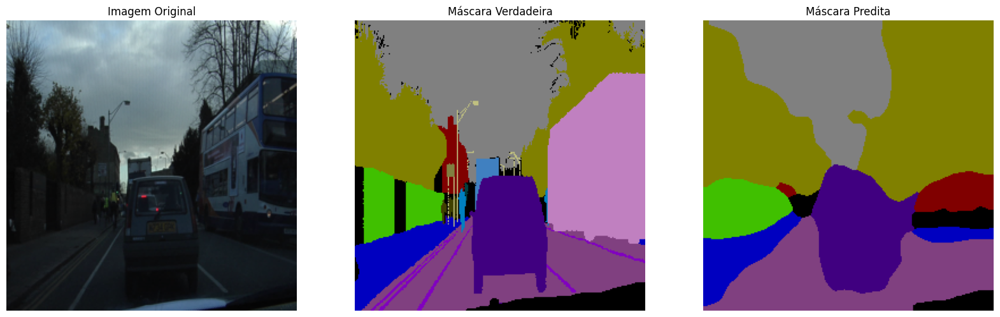

Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [11/50] - Tempo: 20.15s - Train Loss: 0.6003 | Val Loss: 0.6817 | Val IoU: 0.2145


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [12/50] - Tempo: 20.26s - Train Loss: 0.5668 | Val Loss: 0.6511 | Val IoU: 0.2204


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [13/50] - Tempo: 20.21s - Train Loss: 0.5350 | Val Loss: 0.6407 | Val IoU: 0.2245


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [14/50] - Tempo: 19.79s - Train Loss: 0.5216 | Val Loss: 0.6235 | Val IoU: 0.2364


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [15/50] - Tempo: 19.78s - Train Loss: 0.4965 | Val Loss: 0.6027 | Val IoU: 0.2359


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [16/50] - Tempo: 19.72s - Train Loss: 0.4780 | Val Loss: 0.5899 | Val IoU: 0.2452


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [17/50] - Tempo: 19.73s - Train Loss: 0.4589 | Val Loss: 0.5763 | Val IoU: 0.2529


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [18/50] - Tempo: 19.83s - Train Loss: 0.4429 | Val Loss: 0.5697 | Val IoU: 0.2490


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [19/50] - Tempo: 19.81s - Train Loss: 0.4256 | Val Loss: 0.5641 | Val IoU: 0.2580


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [20/50] - Tempo: 19.93s - Train Loss: 0.4127 | Val Loss: 0.5544 | Val IoU: 0.2682


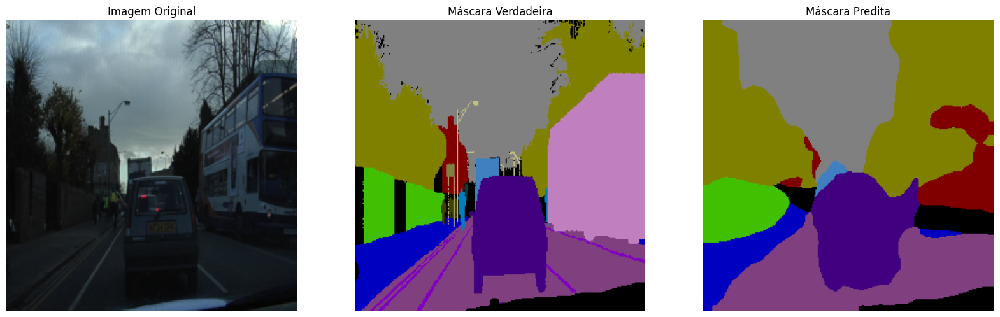

Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [21/50] - Tempo: 19.86s - Train Loss: 0.4021 | Val Loss: 0.5471 | Val IoU: 0.2809


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [22/50] - Tempo: 19.79s - Train Loss: 0.3887 | Val Loss: 0.5361 | Val IoU: 0.2763


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [23/50] - Tempo: 20.26s - Train Loss: 0.3775 | Val Loss: 0.5301 | Val IoU: 0.2829


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [24/50] - Tempo: 20.48s - Train Loss: 0.3677 | Val Loss: 0.5274 | Val IoU: 0.2839


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [25/50] - Tempo: 19.75s - Train Loss: 0.3581 | Val Loss: 0.5158 | Val IoU: 0.2888


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [26/50] - Tempo: 20.00s - Train Loss: 0.3550 | Val Loss: 0.5158 | Val IoU: 0.2945


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [27/50] - Tempo: 20.14s - Train Loss: 0.3480 | Val Loss: 0.5179 | Val IoU: 0.2906


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [28/50] - Tempo: 20.23s - Train Loss: 0.3412 | Val Loss: 0.5119 | Val IoU: 0.2938


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [29/50] - Tempo: 19.61s - Train Loss: 0.3338 | Val Loss: 0.5037 | Val IoU: 0.3039


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [30/50] - Tempo: 19.98s - Train Loss: 0.3290 | Val Loss: 0.5193 | Val IoU: 0.2921


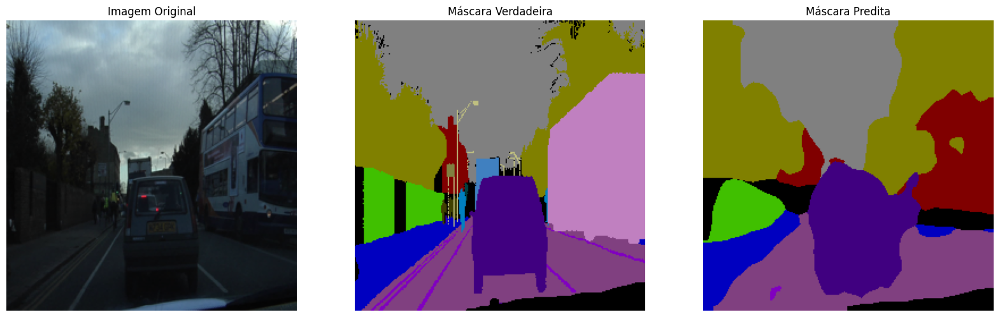

Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [31/50] - Tempo: 20.00s - Train Loss: 0.3245 | Val Loss: 0.5034 | Val IoU: 0.2979


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [32/50] - Tempo: 19.94s - Train Loss: 0.3169 | Val Loss: 0.5006 | Val IoU: 0.3021


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [33/50] - Tempo: 20.07s - Train Loss: 0.3146 | Val Loss: 0.5036 | Val IoU: 0.2933


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [34/50] - Tempo: 19.75s - Train Loss: 0.3114 | Val Loss: 0.4891 | Val IoU: 0.3012


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [35/50] - Tempo: 19.81s - Train Loss: 0.3062 | Val Loss: 0.5014 | Val IoU: 0.3051


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [36/50] - Tempo: 19.94s - Train Loss: 0.3030 | Val Loss: 0.4979 | Val IoU: 0.2987


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [37/50] - Tempo: 20.17s - Train Loss: 0.2950 | Val Loss: 0.4866 | Val IoU: 0.3096


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [38/50] - Tempo: 20.03s - Train Loss: 0.2907 | Val Loss: 0.4883 | Val IoU: 0.3070


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [39/50] - Tempo: 19.90s - Train Loss: 0.2894 | Val Loss: 0.4912 | Val IoU: 0.3084


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [40/50] - Tempo: 19.91s - Train Loss: 0.2860 | Val Loss: 0.4873 | Val IoU: 0.3063


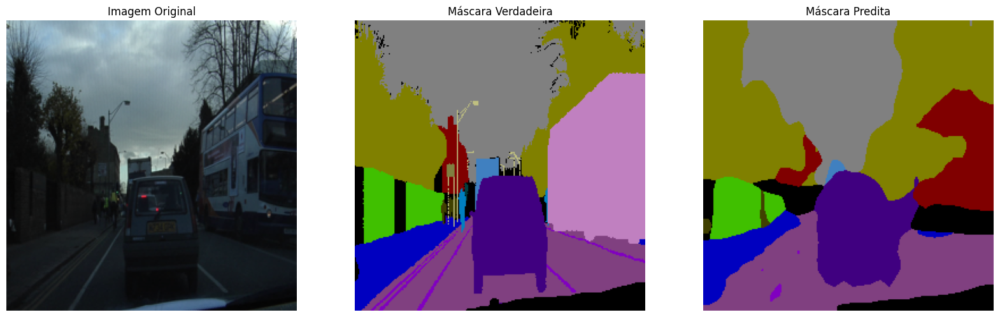

Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [41/50] - Tempo: 19.70s - Train Loss: 0.2824 | Val Loss: 0.4904 | Val IoU: 0.3049


Training:   0%|          | 0/46 [00:00<?, ?it/s]

Validation:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch [42/50] - Tempo: 20.05s - Train Loss: 0.2794 | Val Loss: 0.4889 | Val IoU: 0.3127
--- PARADA ANTECIPADA NA EPOCH 42 ---
Treinamento finalizado. Carregando o melhor modelo encontrado...

Fine-tuning do 'DeepLabV3-RN101 | Adam+CE' concluído!


In [13]:
# =========================================================
#                FINE TUNING DO DeepLabV3
# =========================================================

# Classe que ajuda a passar dicionario pra tensor
class DeepLabWrapper(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model

    def forward(self, x):
        output = self.model(x)
        return output['out'] # Convenção do PyTorch

deeplab_params = {
    "nome_teste": "DeepLabV3-RN101 | Adam+CE", "model_type": "DeepLabV3", "optimizer": "Adam", "loss_fn": "CrossEntropyLoss",
    "lr": 1e-4, "batch_size": 8
}

EPOCHS = 50
PATIENCE = 5
resultados_gerais = {} 

print("\n" + "="*50)
print(f"INICIANDO FINE-TUNING: {deeplab_params['nome_teste']}")
print("="*50)


# drop_last=True evita erros
train_dataloader = DataLoader(train_dataset, batch_size=deeplab_params['batch_size'], shuffle=True, num_workers=2, pin_memory=True, drop_last=True)
val_dataloader = DataLoader(val_dataset, batch_size=deeplab_params['batch_size'], shuffle=False, num_workers=2, pin_memory=True)

# Modelo Original
deeplab_original = deeplabv3_resnet101(weights=DeepLabV3_ResNet101_Weights.DEFAULT)
# Ajusta as camadas de classificação
deeplab_original.classifier[4] = nn.Conv2d(256, num_classes, kernel_size=(1, 1), stride=(1, 1))
deeplab_original.aux_classifier[4] = nn.Conv2d(256, num_classes, kernel_size=(1, 1), stride=(1, 1))

# Congela o backbone
for name, param in deeplab_original.named_parameters():
    if "backbone" in name:
        param.requires_grad = False


# Definições
model = DeepLabWrapper(deeplab_original).to(DEVICE)
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()), 
    lr=deeplab_params['lr']
)

# Treinamento
trainer = Trainer(model, train_dataloader, val_dataloader, optimizer, loss_fn, DEVICE, num_classes)
history = trainer.fit(EPOCHS, PATIENCE, color_map) # Passando val_dataset para a checagem

# Salva o histórico e os pesos
resultados_gerais[deeplab_params['nome_teste']] = history
# Salva os pesos do modelo original, não do wrapper
torch.save(deeplab_original.state_dict(), f"{deeplab_params['nome_teste'].replace(' ', '_')}_best.pth")

print(f"\nFine-tuning do '{deeplab_params['nome_teste']}' concluído!")

Usando o dispositivo: cuda
Carregando o melhor modelo U-Net...
Modelo U-Net carregado com sucesso!

Carregando o melhor modelo DeepLabV3...


Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth
100%|██████████| 171M/171M [00:00<00:00, 232MB/s]


Modelo DeepLabV3 pronto para a comparação!


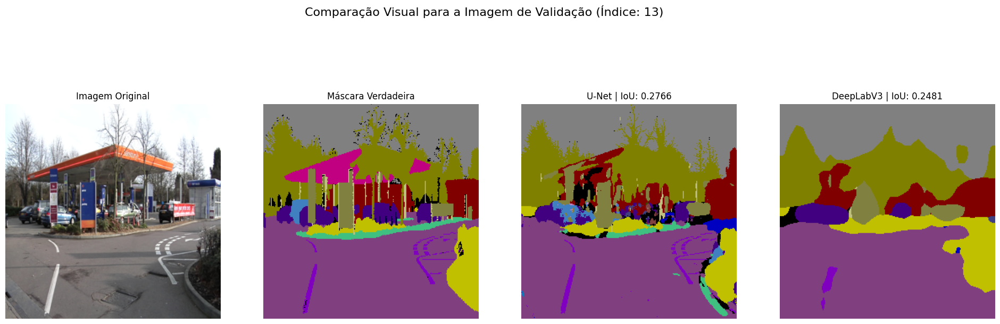

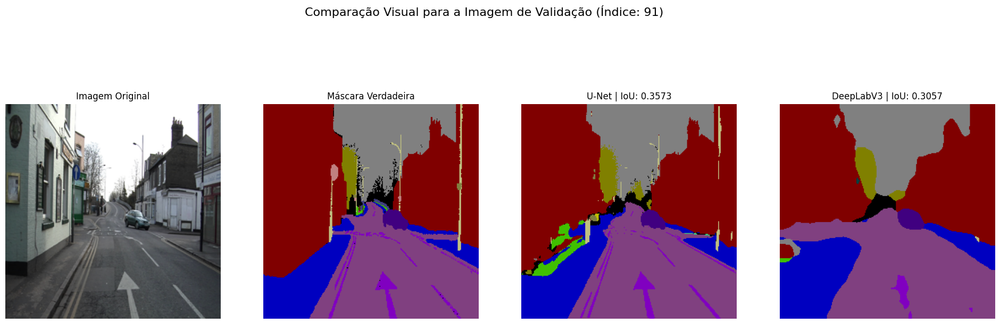

In [14]:
# =========================================================
#       COMPARAÇÃO: TREINANDO DO ZERO X FINE TUNING
# =========================================================

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Usando o dispositivo: {DEVICE}")

# Carrgando o melhor modelo treinado do zero
print("Carregando o melhor modelo U-Net...")
best_unet_name = "Adam+CE | D4 F64"
best_unet_params = next(p for p in parametros_teste if p['nome_teste'] == best_unet_name)

num_classes = len(color_map)
unet_model = UNet(
    in_channels=3, 
    out_channels=num_classes,
    depth=best_unet_params['depth'],
    features=best_unet_params['features']
).to(DEVICE)

unet_weights_path = "/kaggle/input/adam-ce-d4-f64-potente-20250914-best/Adam_CE___D4_F64__potente___20250914-183031__best.pth"
unet_model.load_state_dict(torch.load(unet_weights_path, map_location=DEVICE))
unet_model.eval()
print("Modelo U-Net carregado com sucesso!")


# Carregando o modelo treinado pelo DeepLab
print("\nCarregando o melhor modelo DeepLabV3...")

# Instanciamos o modelo base com a arquitetura necessária
deeplab_base = torchvision.models.segmentation.deeplabv3_resnet101(
    weights=None, 
    num_classes=num_classes,
    aux_loss=True 
)

deeplab_weights_path = "/kaggle/working/DeepLabV3-RN101_|_Adam+CE_best.pth"
deeplab_base.load_state_dict(torch.load(deeplab_weights_path, map_location=DEVICE))
deeplab_model = DeepLabWrapper(deeplab_base).to(DEVICE)
deeplab_model.eval()

print("Modelo DeepLabV3 pronto para a comparação!")

# Função pra Comparar Visualmente
def compare_models_visualy(unet, deeplab, val_dataset, color_map, device, num_examples=2):

    iou_metric = MulticlassJaccardIndex(num_classes=len(color_map)).to(device)

    for _ in range(num_examples):
        # Pega uma imagem aleatória
        idx = np.random.randint(0, len(val_dataset))
        image_tensor, true_mask_tensor = val_dataset[idx]
        
        # Prepara a imagem e a máscara para o modelo
        image_batch = image_tensor.unsqueeze(0).to(device, dtype=torch.float32)
        mask_batch = true_mask_tensor.unsqueeze(0).to(device, dtype=torch.long)

        with torch.no_grad():
            pred_unet_raw = unet(image_batch)
            pred_mask_unet = torch.argmax(pred_unet_raw, dim=1)

            pred_deeplab_raw = deeplab(image_batch)
            pred_mask_deeplab = torch.argmax(pred_deeplab_raw, dim=1)

            # Calcula IoU para a U-Net
            iou_metric.reset()
            iou_unet = iou_metric(pred_unet_raw, mask_batch).item()
            
            # Calcula IoU para o DeepLabV3
            iou_metric.reset()
            iou_deeplab = iou_metric(pred_deeplab_raw, mask_batch).item()

        # Prepara os tensores para plotagem
        image_np = denormalize_img(image_tensor).permute(1, 2, 0).cpu().numpy()
        true_mask_rgb = mask_to_rgb(true_mask_tensor.numpy(), color_map)
        unet_mask_rgb = mask_to_rgb(pred_mask_unet.squeeze(0).cpu().numpy(), color_map)
        deeplab_mask_rgb = mask_to_rgb(pred_mask_deeplab.squeeze(0).cpu().numpy(), color_map)
        
        # Plotagem
        fig, axes = plt.subplots(1, 4, figsize=(24, 8))
        fig.suptitle(f'Comparação Visual para a Imagem de Validação (Índice: {idx})', fontsize=16)
        
        axes[0].imshow(image_np); axes[0].set_title("Imagem Original"); axes[0].axis('off')
        axes[1].imshow(true_mask_rgb); axes[1].set_title("Máscara Verdadeira"); axes[1].axis('off')
        axes[2].imshow(unet_mask_rgb); axes[2].set_title(f"U-Net | IoU: {iou_unet:.4f}"); axes[2].axis('off')
        axes[3].imshow(deeplab_mask_rgb); axes[3].set_title(f"DeepLabV3 | IoU: {iou_deeplab:.4f}"); axes[3].axis('off')
        
        plt.show()

compare_models_visualy(
    unet_model, 
    deeplab_model, 
    val_dataset, 
    color_map, 
    DEVICE, 
    num_examples=2
)

#### Fine-Tuning vs Treinar do Zero

A comparação lado a lado das máscaras preditas evidencia nuencias importantes que vão além da performance. Primeiramente, pelo treinamento, nota-se que o modelo DeepLab não começou com predições ruins. A base do modelo já o conduz a segmentar com certa acertividade grandes características das imagens. Também é interessante notar que o DeepLab possui fronteiras entre as classes muito mais suaves, o que, em grande parte, diminui um noise desnecessário que o modelo treinado do zero apresenta. Por último, é importante salientar que o modelo Unet que treinamos uitlizou 100 épocas, mas o DeepLab apenas 50, logo o DeepLab é muito promissor e, com diferentes parâmetros, poderia até superar o nosso modelo.
